# DISCHARGE FORECASTING WITH PYCARET

Author: Tobias Siegfried, hydrosolutions GmbH
Source inspiration: https://pycaret.gitbook.io/docs/learn-pycaret/official-blog/time-series-101-for-beginners

This tutorial is a quick introduction to time series forecasting with pycaret. It is intended for beginners who are new to time series forecasting and pycaret. It uses a tailored regression approach as explained in the above-linked tutorial.

# I. Change Log
- 2023-04-20: 
  - Initial version
- 2023-04-23: 
  - Upgraded packages.
- 2023-04-23: 
  - New MBP environment pycaret_310 (works)
- 2023-05-25: 
  - Starting to add more features to the model. More precisely, we now have SCF for individual elevation bands in the catchment (see also https://hydrosolutions.users.earthengine.app/view/centralasia-snowcover-eb for the GEE app with which these data were produced)
- 2023-05-25: 
  - new branch scf_eb which is now the development branch for the model with SCF for individual elevation bands.
- 2023-05-29: 
  - updated data paths and integration of new data (swe). new MCair environment via
  - conda create --name pycaret_air python=3.10.10
  - pip install 'pycaret[full]' (Note: for reference, we can add the flag --upgrade to upgrade the package))
  - This resulted in a Failed to build lightgbm error. This is fixed by installing the latest version of cmake as per: 
      brew install cmake libomp
  - rerun the pip install 'pycaret[full]' command
  - After then running into numpy problems, I had to uninstall and reinstall the latter and after a few more rounds of trials, I got there.
- 2023-05-30: Integration of swe data. Added Data Wrangler Preview for better handling and exploring the datasets in Jupyter notebooks.
- 2023-05-31: 
  - remove fastai dependency (not needed for this model).
  - various git related housekeeping tasks, i.e. finished scf_eb branch and merged into main. Working on dev branch now.
  - starting to work on modeling related tasks. 
- 2023-06-01: 
  - different modeling tests for baseline models.
  - add mean SCF and mean SWE averaged over all elevation bands as features.
  - deleted all previous garbage code.
- 2023-06-06:
  - revamped modeling section and continuing to work on it. Time Series Model with Long Lag Features is working. Testing different forecasting horizons and model performance.
  - running into an issue with external regressors. Whatever key I pass, the predictions are always the same. Filed a question on Slack.
- 2023-06-07: 
  - working on a reproducible example for the external regressors issue.
  - making data available on GitHub inside the pycaret_3 folder. 
  - made available are discharge of interest.
  - stored ocean indices data in ./code/pycaret_3/data/ocean_indices. Note, all these data export is done from the lab_63_nested_modeltime RProject in the Govshut folder.
  - time series models no longer working after add prophet package to environment and after updating anaconda (which is not a good idea!)
  - Setting up new env pycaret_3_0_2 and installing prophet first with 
    -- conda install -c conda-forge prophet
  and then continuing to install pycaret with
    -- pip install 'pycaret[full]'
- 2023-06-08: 
  - Create a quickstart Section to quickly load the final .csv data before the beginning of the modeling section.
  - several further small improvements. 
  - Kicked out regression models. PyCaret 3.0.2 does have time series models that can do all in an automatized fashion so that we do not need to use regression models anymore (see https://github.com/pycaret/pycaret/discussions/1760 for a discussion on this topic). In short, the regression module is for regression, the time series module is for time series.
  - Added a new section on how to blend models.
  - Added to the documentation in general.
- 2023-06-09: 
  - further improvements and code clean up.
  - Consistently kicking out all this transformation and back-transformation code. This is all done by pycaret now.
  - Adding ChatGPT background information for the uninitiated reader and more context specific information. This can all serve as great learning material for the future for Central Asia Hydromet forecasting experts.
  - Adding a generic experiment section. If MLFlow is really that useful in logging and tracking experiments, we should use it. That means, that we can just fiddle with a generic forecasting code block without having to copy and paste the whole code block again and again for all experiments. At least that is the thinking right now and the direction that I am pushing towards.
  - Added new Model Experiments section.
  - Added background information on MLflow (derived from a ChatGPT query).
  - Greatly improved and streamlined Chapter 5.
  - Added comparison of baseline time series model predictions and well performing model with external regressors.
  - Added finalization of baseline time series model.
  - Entirely removed baseline regression model.
  - further clean up of code and documentation.
  - starting to prepare a reproducible example of the issues in relation to forecasting. The idea here is to file this as an issue on GitHub.
- 2023-06-12: 
  - preparing standalone Google COLAB notebook for issue filing on GitHub.
  - Upload relevant experiment data to GitHub.
  - Filed issue #3602 on GitHub. Check it out here: https://github.com/pycaret/pycaret/issues/3602
  - Another lead on how to properly use external regressors in time series forecasting in PyCaret is here: https://github.com/pycaret/pycaret/issues/3548, especially the reply by @ngupta23. Take these comments into account!  
  - Learned a great deal in the later post and will update the code accordingly. Maybe good to get a feeling of what that `WindowSummarizer` is exactly doing in a separate section (see https://gist.github.com/ngupta23/361d353ddd5e4b55c2f46d8fab6d4b44).
- 2023-06-13:
  - Check on this `WindowSummarizer` (see Section 2.4.alt).
- 2023-06-14:
  - Develop a model with the `WindowSummarizer`.
  - Creating a backup and throwing out all baggage not needed anymore with future dataframe, lagged rolling variables, etc. Backup name: 2023_06_14_time_series_fc_101_pycaret_bu.ipynb
- 2023-06-15:
  - DagsHub integration. Repository name on dagshub is: tobiassiegfried/pycaret_3_forecasting. See also Moez Ali for more information here: https://www.moez.ai/2021/05/02/introduction-to-pycaret-for-beginners/ 
  - Started experiment logging.
  - Trying to understand the workflow for model training and retraining once we gain more data over time. For a hint, see here: https://github.com/pycaret/pycaret/discussions/2844 
  - Merging to main before invitation of Bea to repo.
  - just renamed the Jupyter Notebook to monthly_seasonal_fc.ipynb
  - Trying to integrate naming conventions so that it actually is clear that this script is for monthly/seasonal predictions.
- 2023-07-05:
  - updated environment to pycaret 3.0.4
    - conda create --name pycaret_3_0_4 python=3.10.10
    - conda activate pycaret_3_0_4  
    - conda install -c conda-forge prophet 
    - pip install 'pycaret[full]'

# II. BACKGROUND 

## II.1 General Considerations

Some background on machine learning and time series forecasting in general.

**1. Understand the Problem and Choose the Right Model:**
Always begin by understanding the problem you're trying to solve. Is it a classification or a regression problem? Maybe it's a clustering problem. Understanding the problem helps you choose the right machine learning algorithm to apply. The "No Free Lunch Theorem" of machine learning suggests there's no one-size-fits-all algorithm, so picking the right one is crucial.

**2. Preprocessing is Important:**
Always clean your data before running it through an algorithm. This includes handling missing values, outliers, and categorical variables. Normalization or standardization can be crucial for some algorithms. Feature engineering, including combining different features, is also often a helpful step.

**3. Split Your Data:**
Split your data into training, validation, and testing sets. A common ratio is 70:15:15 or 80:10:10. This will help you avoid overfitting to your training data.

**4. Build a Baseline Model:**
Always start with a simple model to understand the problem's baseline performance. It gives you a benchmark against which you can compare the performance of more complex models. 

**5. Gradually Increase Complexity:**
Once your baseline model is performing satisfactorily, you can move to more complex models. This could mean using more complex algorithms, adding more features, or fine-tuning your model parameters.

**6. Regularization and Hyperparameter Tuning:**
Regularization methods such as Lasso and Ridge can help prevent overfitting. Also, consider using techniques such as grid search or random search to optimize your model's hyperparameters.

**7. Validate Your Model:**
Check your model's performance on the validation set to make sure it generalizes well. Keep an eye on metrics relevant to your specific problem. For example, accuracy isn't always the best metric, especially for imbalanced datasets.

**8. Use Cross-Validation:**
Cross-validation (e.g., K-fold cross-validation) is a good technique to ensure that your model is not fitting to specific artifacts in your data and generalizes well to unseen data.

**9. Evaluate on Test Set:**
Once you are satisfied with your model's performance on the validation set, evaluate it on the test set. This should give you an idea of how well your model will perform in the real world.

**10. Keep the Model Up-to-Date:**
Machine learning models often need to be retrained with new data to maintain their performance. Establish a schedule to periodically update your models.

**11. Understand and Communicate Your Results:**
Machine learning isn't just about building models; it's also about understanding and communicating your results. Make sure to spend time visualizing, interpreting, and communicating your results in a way that is understandable to stakeholders.

**12. Ethical Considerations:**
Always consider the ethical implications of your work. Be aware of potential biases in your data and the potential consequences of false positives or negatives.

Remember, the goal is not to create the most complex model, but the simplest model that still performs well. "Occam's razor" is often quoted in machine learning: Given two explanations, the simpler one is usually better. It's not just about accuracy, but also interpretability, computational efficiency, and simplicity.

## II.2 Specific Considerations for our Context

We use the latest version of the PyCaret low code machine learning library. For more information, see https://pycaret.org/. Specifically, we use the TimeSeries Module there which became available with version 3.0.0. This basically allows us to take care of most of the steps mentioned above (2,3,6,7,8,9,10) in a very efficient and automatized fashion and allows us to focus on the problem at hand and on how best to use our domain knowledge to improve the model.


# III PACKAGES & SETTINGS

## III.1 Packages

In [1]:
# dagshub
import os
os.environ["DAGSHUB_USER_TOKEN"] = "ea8a4760ef9ac86094dca18580bc63e95c8bdce9"
os.environ['MLFLOW_TRACKING_URI'] = "https://dagshub.com/tobiassiegfried/pycaret_3_forecasting.mlflow"

# elemental stuff for time series forecasting with pycaret
import numpy as np
import pandas as pd

# testing sktime WindowSummarizer
from sktime.transformations.series.summarize import WindowSummarizer # this is for the creation of various types of 
# lagged and lagged rolling features 

# data visualization
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import seaborn as sns

# check installation
def what_is_installed():
    from pycaret import show_versions
    show_versions()

try:
    what_is_installed()
except ModuleNotFoundError:
    !pip install 'pycaret[full]'
    what_is_installed()


System:
    python: 3.10.11 | packaged by conda-forge | (main, May 10 2023, 19:01:19) [Clang 14.0.6 ]
executable: /Users/tobiassiegfried/miniconda3/envs/pycaret_air/bin/python
   machine: macOS-13.4-arm64-arm-64bit

PyCaret required dependencies:
                 pip: 23.1.2
          setuptools: 67.7.2
             pycaret: 3.0.2
             IPython: 8.13.2
          ipywidgets: 7.7.5
                tqdm: 4.65.0
               numpy: 1.24.3
              pandas: 1.5.3
              jinja2: 3.1.2
               scipy: 1.10.1
              joblib: 1.2.0
             sklearn: 1.2.2
                pyod: 1.0.9
            imblearn: 0.10.1
   category_encoders: 2.6.1
            lightgbm: 3.3.5
               numba: 0.57.0
            requests: 2.31.0
          matplotlib: 3.7.1
          scikitplot: 0.3.7
         yellowbrick: 1.5
              plotly: 5.14.1
             kaleido: 0.2.1
         statsmodels: 0.14.0
              sktime: 0.17.0
               tbats: 1.1.3
            pm

## III.2 Settings

In [2]:
global_fig_settings = {
    "renderer": "notebook",
    #"renderer": "png",
    "width": 1000,
    "height": 600,
    "template": "simple_white"
}

## III.3 Functions

Just some helper functions defined here.

We define a function that transforms (log1p) and zscores discharge data. Also, define and inverse function to transforms back. Note, the function has been tested with the data from the repository. All seems to work fine.

In [3]:
def transform_and_zscore(df, columns):
    # Create an empty dictionary to store mean and std for each column
    mean_std_dict = {}
    
    for col in columns:
        # Apply log1p transformation
        df[col] = np.log1p(df[col])
        
        # Calculate mean and std of the transformed column
        mean = df[col].mean()
        std = df[col].std()
        
        # Store mean and std in the dictionary
        mean_std_dict[col] = {'mean': mean, 'std': std}
        
        # Compute z-scores
        df[col] = (df[col] - mean) / std
        
    return df, mean_std_dict

def inverse_transform_and_zscore(df, columns, mean_std_dict):
    for col in columns:
        # Retrieve the original mean and std from the mean_std_dict
        mean = mean_std_dict[col]['mean']
        std = mean_std_dict[col]['std']
        
        # Apply the inverse z-score transformation
        df[col] = df[col] * std + mean
        
        # Apply the inverse log1p transformation
        df[col] = np.expm1(df[col])
        
    return df

# =====================

# 1 LOAD DATA

For monthly and seasonal predictions, we currently use monthly data from 2000 to 2022. Since the satellite-based snow cover fraction (SCF) data are only available from 2001 onwards, we will use this period 2001 - 2022 for now. 

## 1.1 Inflow Toktogul Data

This dataframe now contains the target variable (inflow q) and the ocean indices NAO and PDO data.

In [50]:
file_path = "./data/discharge/q_2001_2022.csv"
q_16936 = pd.read_csv(file_path, parse_dates=True)
q_16936 = q_16936[['date', 'q_16936']] # we only need these columns as scf data is now available at the level of elevation bands.
q_16936.rename(columns={'q_16936':'q'}, inplace=True) # just making notation easier
q_16936['date'] = pd.to_datetime(q_16936['date']) # make sure that the date column is of type datetime
q_16936.head()

,date,q
0,2001-01-31,173.0
1,2001-02-28,169.0
2,2001-03-31,202.0
3,2001-04-30,329.0
4,2001-05-31,761.0


In [51]:
# checking data types just to confirm that all is well
q_16936.dtypes

date    datetime64[ns]
q              float64
dtype: object

## 1.2 Elevation Band Snow Cover Fraction Data
Silvan was kind enough to produce a special version of the SnowMapper App for us. It produces snow cover fraction (SCF) data for individual elevation bands in the catchment based on monthly MODIS Snowcover (MODIS/Terra Snow Cover Daily L3 Global 500m SIN Grid, Version 6 (MOD10A1)). The data is stored in a Google Earth Engine asset. We can access it via the GEE API and then load it here for inclusion in the forecasting model(s). The App is available at https://hydrosolutions.users.earthengine.app/view/centralasia-snowcover-eb  

In [52]:
# load data from csv file
scf_eb = pd.read_csv('./data/scf/scf_eb_2000_2022.csv')
# delete the first and last columns of the scf_eb data frame
scf_eb.drop(scf_eb.columns[[0, -1]], axis=1, inplace=True)
scf_eb_names = scf_eb.columns.to_list()
scf_eb_names = [scf_eb_names[-1]] + scf_eb_names[:-1]
scf_eb = scf_eb[scf_eb_names]
# convert first column to datetime
scf_eb['Year-Month'] = pd.to_datetime(scf_eb['Year-Month'])
# select columns of interest containing the 'Year-Month' column and all columns that contain the string 'Inflow Toktogul'
scf_eb = scf_eb.loc[:, scf_eb.columns.str.contains('Year-Month|Inflow Toktogul')]
# sort by date
scf_eb = scf_eb.sort_values(by='Year-Month')
scf_eb.rename(columns={'Year-Month':'date'}, inplace=True)
# add one month to date column and subtract one day to arrive at the last day of the month.
scf_eb['date'] = scf_eb['date'] + pd.DateOffset(months=1) - pd.DateOffset(days=1)

#zscore the SCF data
scf_eb_zs = scf_eb.copy()
scf_eb_data_col = scf_eb_zs.columns.to_list()
#remove first element of list
scf_eb_data_col = scf_eb_data_col[1:]
[scf_eb_zs,transform_dict_scf] = transform_and_zscore(scf_eb_zs, scf_eb_data_col)
# rename columns of scf_eb_zs dataframe from "16936_01_Inflow Toktogul" to  scf_1, from "16936_01_Inflow Toktogul" to scf_2, etc.
scf_eb_zs.columns = ['date'] + ['scf_' + str(i) for i in range(1, len(scf_eb_zs.columns))]
scf_eb_zs.reset_index(drop=True, inplace=True)
# compute average over all scf columns
scf_eb_zs['scf_mean'] = scf_eb_zs.iloc[:, 1:].mean(axis=1)
# just output for control
scf_eb_zs.head()

,date,scf_1,scf_2,scf_3,scf_4,scf_5,scf_6,scf_7,scf_8,scf_9,scf_10,scf_mean
0,2001-01-31,1.443212,1.326254,1.254712,1.139829,1.038584,0.979233,0.894285,0.868363,0.783711,0.768391,1.049657
1,2001-02-28,1.476665,1.366830,1.272393,1.152085,1.024153,0.994329,0.880934,0.875968,0.794634,0.785051,1.062304
2,2001-03-31,0.818005,0.881100,0.922082,0.992940,0.952463,0.960494,0.853219,0.817256,0.743146,0.730817,0.867152
3,2001-04-30,-0.809901,-0.169371,0.008092,0.351249,0.573201,0.652818,0.679062,0.657671,0.643454,0.593667,0.317994
4,2001-05-31,-0.885435,-1.014140,-1.101474,-1.196773,-0.761922,-0.256133,-0.083726,0.029316,0.237240,0.346863,-0.468618


## 1.3 Snow Water Equivalent Data (SLF SWE Model)
We load the SWE data from the repository. The original data are preprocessed in R and then stored in the repository. See ../SAPPHIRE_Central_Asia_Technical_Work/code/swe_prep/ for more details.

In [53]:
swe_eb = pd.read_csv('./data/swe/swe_16936_eb_1999_2022_m.csv')
# pivot long to wide
swe_eb_wide = swe_eb.pivot(index='date', columns='name', values='swe_month').reset_index()
# add one month and subtract one day to arrive at the last day of the month.
swe_eb_wide['date'] = pd.to_datetime(swe_eb_wide['date'])
swe_eb_wide['date'] = swe_eb_wide['date'] + pd.DateOffset(months=1) - pd.DateOffset(days=1)
# ====================================================================================================
swe_eb_zs = swe_eb_wide.copy()
[swe_eb_zs, transform_dict_swe] = transform_and_zscore(swe_eb_wide, swe_eb_wide.columns.to_list()[1:])
# rename columns of swe_eb_zs dataframe from "V1" to  swe_1, from "V2" to scf_2, etc.
swe_eb_zs.columns = ['date'] + ['swe_' + str(i) for i in range(1, len(swe_eb_zs.columns))]
# compute average over all swe columns
swe_eb_zs['swe_mean'] = swe_eb_zs.iloc[:, 1:].mean(axis=1)
# just output for control
swe_eb_zs.head()

,date,swe_1,swe_2,swe_3,swe_4,swe_5,swe_6,swe_7,swe_8,swe_9,swe_10,swe_mean
0,2001-01-31,0.824001,0.680480,0.825266,0.855616,0.867583,0.865696,0.865057,0.851500,0.841521,0.815221,0.829194
1,2001-02-28,0.911508,0.761912,0.903006,0.931954,0.944387,0.943585,0.947670,0.945791,0.933958,0.902449,0.912622
2,2001-03-31,0.930736,0.815771,0.933013,0.954617,0.971981,0.977601,0.985669,0.988979,0.974633,0.945456,0.947845
3,2001-04-30,0.863098,0.901502,0.901823,0.904559,0.924013,0.954188,0.962000,0.971105,0.959889,0.959989,0.930217
4,2001-05-31,0.561714,0.652727,0.620792,0.588561,0.581306,0.618855,0.621538,0.623001,0.631869,0.653896,0.615426


## 1.4 Ocean Indices Data
Here, we load the data of the PDO and NAO indices which might also play a role in the prediction of discharge.

In [54]:
oi = pd.read_csv('./data/ocean_indices/oi_2001_2022.csv')
oi['date'] = pd.to_datetime(oi['date'])
oi.head()


,date,index_NAO,index_PDO
0,2001-01-31,0.25,0.60
1,2001-02-28,0.45,0.29
2,2001-03-31,-1.26,0.45
3,2001-04-30,0.00,-0.31
4,2001-05-31,-0.02,-0.30


# 2 PREPROCESSING & FEATURE ENGINEERING

## 2.1 Combine Data

We are combining the dataframes into one data frame. We will use this dataframe for the model. It includes the target variable (inflow q), the ocean indices NAO and PDO, and the snow cover fraction and snow water equivalent data for the elevation bands in the upstream Naryn catchment.

Note, we are keeping the original target variable as PyCaret has algorithms that can handle non-normalized data.

In [55]:
#Combine q_16936_xreg, scf_eb_zs, and swe_eb_zs into a single dataframe
prep_data = pd.merge(q_16936, scf_eb_zs, on='date', how='left')
prep_data = pd.merge(prep_data, swe_eb_zs, on='date', how='left')
prep_data = pd.merge(prep_data, oi, on='date', how='left')
prep_data.head()

,date,q,scf_1,scf_2,scf_3,scf_4,scf_5,scf_6,scf_7,scf_8,...,swe_4,swe_5,swe_6,swe_7,swe_8,swe_9,swe_10,swe_mean,index_NAO,index_PDO
0,2001-01-31,173.0,1.443212,1.326254,1.254712,1.139829,1.038584,0.979233,0.894285,0.868363,...,0.855616,0.867583,0.865696,0.865057,0.851500,0.841521,0.815221,0.829194,0.25,0.60
1,2001-02-28,169.0,1.476665,1.366830,1.272393,1.152085,1.024153,0.994329,0.880934,0.875968,...,0.931954,0.944387,0.943585,0.947670,0.945791,0.933958,0.902449,0.912622,0.45,0.29
2,2001-03-31,202.0,0.818005,0.881100,0.922082,0.992940,0.952463,0.960494,0.853219,0.817256,...,0.954617,0.971981,0.977601,0.985669,0.988979,0.974633,0.945456,0.947845,-1.26,0.45
3,2001-04-30,329.0,-0.809901,-0.169371,0.008092,0.351249,0.573201,0.652818,0.679062,0.657671,...,0.904559,0.924013,0.954188,0.962000,0.971105,0.959889,0.959989,0.930217,0.00,-0.31
4,2001-05-31,761.0,-0.885435,-1.014140,-1.101474,-1.196773,-0.761922,-0.256133,-0.083726,0.029316,...,0.588561,0.581306,0.618855,0.621538,0.623001,0.631869,0.653896,0.615426,-0.02,-0.30


## 2.2 Account for Acquisition Delays

We need to account for the acquisition delays of the satellite data in the case of the scf data. This is done by shifting the corresponding data in time. For the moment, we can set an acquisition delay of one month here. This is definitely something that needs to be validated (in the case of scf data) and also discussed with Joel for the swe data.

In [56]:
# Find all columns that contain the string 'scf' and lag them by 1 month
scf_cols = prep_data.columns[prep_data.columns.str.contains('scf')]
swe_cols = prep_data.columns[prep_data.columns.str.contains('swe')]
oi_cols = prep_data.columns[prep_data.columns.str.contains('oi')]
prep_data[scf_cols] = prep_data[scf_cols].shift(1)
prep_data[swe_cols] = prep_data[swe_cols].shift(1)
prep_data[oi_cols] = prep_data[oi_cols].shift(1)
prep_data.head()

,date,q,scf_1,scf_2,scf_3,scf_4,scf_5,scf_6,scf_7,scf_8,...,swe_4,swe_5,swe_6,swe_7,swe_8,swe_9,swe_10,swe_mean,index_NAO,index_PDO
0,2001-01-31,173.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.25,0.60
1,2001-02-28,169.0,1.443212,1.326254,1.254712,1.139829,1.038584,0.979233,0.894285,0.868363,...,0.855616,0.867583,0.865696,0.865057,0.851500,0.841521,0.815221,0.829194,0.45,0.29
2,2001-03-31,202.0,1.476665,1.366830,1.272393,1.152085,1.024153,0.994329,0.880934,0.875968,...,0.931954,0.944387,0.943585,0.947670,0.945791,0.933958,0.902449,0.912622,-1.26,0.45
3,2001-04-30,329.0,0.818005,0.881100,0.922082,0.992940,0.952463,0.960494,0.853219,0.817256,...,0.954617,0.971981,0.977601,0.985669,0.988979,0.974633,0.945456,0.947845,0.00,-0.31
4,2001-05-31,761.0,-0.809901,-0.169371,0.008092,0.351249,0.573201,0.652818,0.679062,0.657671,...,0.904559,0.924013,0.954188,0.962000,0.971105,0.959889,0.959989,0.930217,-0.02,-0.30


A note here on the ocean indices. These will likely have to be shifted too but we will leave this for now as their value in the whole forecasting exercise is not clear yet (status: 2023-05-31).

## 2.3 Adding Speed of Snowpack Change Data and Acceleration
Could be potentially very interesting predictors. Take the first difference of, scf, and swe. We will use this as an additional feature in the model.

In [57]:
# add speed and acceleration columns for q
prep_data['d_q'] = prep_data['q'].diff()
prep_data['d_d_q'] = prep_data['d_q'].diff()
# take the first difference of the scf columns and rename the resulting columns by adding a 'd_' prefix
prefix = 'd_'
prep_data_d_scf = prep_data[scf_cols].diff().add_prefix(prefix)
prep_data_d_d_scf = prep_data_d_scf.diff().add_prefix(prefix)
# do the same for the swe columns
prep_data_d_swe = prep_data[swe_cols].diff().add_prefix(prefix)
prep_data_d_d_swe = prep_data_d_swe.diff().add_prefix(prefix)


Now, we are ready to add these additional columns that measure the change in scf and swe (speed and acceleration) from one month to the next. We will use these as additional features in the model.

In [58]:
# combine the prep_data dataframe with the prep_data_d_d_scf and prep_data_d_d_swe dataframes
prep_data = pd.concat([prep_data, prep_data_d_scf, prep_data_d_d_scf, prep_data_d_swe, prep_data_d_d_swe], axis=1)
prep_data.head()

,date,q,scf_1,scf_2,scf_3,scf_4,scf_5,scf_6,scf_7,scf_8,...,d_d_swe_2,d_d_swe_3,d_d_swe_4,d_d_swe_5,d_d_swe_6,d_d_swe_7,d_d_swe_8,d_d_swe_9,d_d_swe_10,d_d_swe_mean
0,2001-01-31,173.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2001-02-28,169.0,1.443212,1.326254,1.254712,1.139829,1.038584,0.979233,0.894285,0.868363,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2001-03-31,202.0,1.476665,1.366830,1.272393,1.152085,1.024153,0.994329,0.880934,0.875968,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2001-04-30,329.0,0.818005,0.881100,0.922082,0.992940,0.952463,0.960494,0.853219,0.817256,...,-0.027573,-0.047733,-0.053676,-0.049211,-0.043873,-0.044614,-0.051103,-0.051762,-0.044220,-0.048205
4,2001-05-31,761.0,-0.809901,-0.169371,0.008092,0.351249,0.573201,0.652818,0.679062,0.657671,...,0.031873,-0.061197,-0.072720,-0.075562,-0.057428,-0.061667,-0.061061,-0.055420,-0.028475,-0.052852


,q,d_q,d_d_q
0,173.0,NaN,NaN
1,169.0,-4.0,NaN
2,202.0,33.0,37.0
3,329.0,127.0,94.0
4,761.0,432.0,305.0


<Axes: >

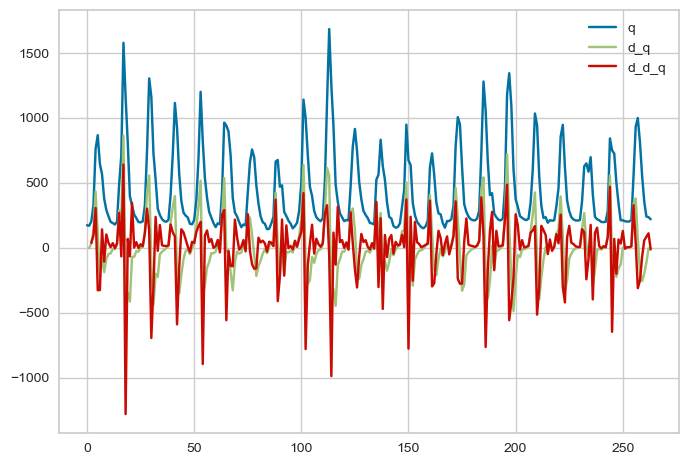

In [68]:
display(prep_data[['q', 'd_q', 'd_d_q']].head())
prep_data[['q', 'd_q', 'd_d_q']].plot()

## 2.4.alt Check sktime WindowSummarizer
PyCaret can access sktime WindowSummarizer. There is no need to do this manually with lagged rolling features!

This is a check on the WindowSummarizer. See https://gist.github.com/ngupta23/361d353ddd5e4b55c2f46d8fab6d4b44 for more details.

Information on the sktime class can be found here:
http://www.sktime.net/en/latest/api_reference/auto_generated/sktime.transformations.series.summarize.WindowSummarizer.html#sktime.transformations.series.summarize.WindowSummarizer

Basically, the WindowSummarizer transforms input series to features based on a provided dictionary of window summarizer, window shifts and window lengths.

Let's try it.


In [59]:
q = q_16936.copy()
q['date'] = pd.to_datetime(q['date'])
q.set_index('date', inplace=True)
# just keep q column    
q = q[['q']]

# define kwargs for WindowSummarizer. Note, the key corresponds to native pandas window functions.
kwargs = {
    "lag_feature": {
       # "lag": [1], # adding simple lags
        "mean": [[6, 6], [6, 12]],
       # "std": [[1, 4]],
    }
}

transformer = WindowSummarizer(**kwargs)
q_transformed = transformer.fit_transform(q)
q_res = pd.concat([q, q_transformed], axis=1)
q_res.reset_index(inplace=True)
display(q_res.head(12))
# plot the results
#fig_windowsummarizer = px.line(q_res, x="date", y=["q", "q_lag_1", "q_mean_1_3", "q_mean_3_6", "q_std_1_4"], template = 'none')
fig_windowsummarizer = px.line(q_res, x="date", y=["q", "q_mean_6_6", "q_mean_6_12"], template = 'none')
fig_windowsummarizer.show()

,date,q,q_mean_6_6,q_mean_6_12
0,2001-01-31,173.0,NaN,NaN
1,2001-02-28,169.0,NaN,NaN
2,2001-03-31,202.0,NaN,NaN
3,2001-04-30,329.0,NaN,NaN
4,2001-05-31,761.0,NaN,NaN
5,2001-06-30,866.0,NaN,NaN
6,2001-07-31,645.0,NaN,NaN
7,2001-08-31,565.0,NaN,NaN
8,2001-09-30,377.0,NaN,NaN
9,2001-10-31,291.0,NaN,NaN


In [60]:
# save prep_data to csv file
prep_data.to_csv('./data/prep_data.csv', index=False)

# 3 EXPLORATORY DATA ANALYSIS

Different types of EDA are performed here including visualizations and correlation analysis.

##   3.1 Overview

Relevant summary statistics can be obtained by the .describe() method. 

In [62]:
prep_data.describe()

,q,scf_1,scf_2,scf_3,scf_4,scf_5,scf_6,scf_7,scf_8,scf_9,...,d_d_swe_2,d_d_swe_3,d_d_swe_4,d_d_swe_5,d_d_swe_6,d_d_swe_7,d_d_swe_8,d_d_swe_9,d_d_swe_10,d_d_swe_mean
count,264.000000,263.000000,263.000000,263.000000,263.000000,263.000000,263.000000,263.000000,263.000000,263.000000,...,258.000000,258.000000,258.000000,258.000000,258.000000,258.000000,258.000000,258.000000,258.000000,258.000000
mean,439.279924,-0.005372,-0.005120,-0.004834,-0.004397,-0.003995,-0.003809,-0.003438,-0.003342,-0.002994,...,-0.003722,-0.002485,-0.002979,-0.002430,-0.002712,-0.003024,-0.002844,-0.002893,-0.003445,-0.002868
std,306.826404,0.998083,0.998434,0.998812,0.999346,0.999794,0.999986,1.000342,1.000428,1.000721,...,1.001811,0.773992,0.682037,0.670179,0.680672,0.726064,0.850498,0.871699,0.870180,0.751331
min,142.000000,-0.914112,-1.014140,-1.148916,-1.351493,-1.486433,-1.714598,-1.893451,-2.127020,-2.502983,...,-4.476703,-3.026558,-2.809813,-2.855063,-3.040431,-3.335638,-3.664940,-3.795871,-3.889647,-3.372521
25%,211.000000,-0.848972,-0.944432,-1.009584,-1.097560,-1.154377,-1.095166,-0.901326,-0.801003,-0.569714,...,-0.366261,-0.328009,-0.282139,-0.291626,-0.298575,-0.304875,-0.319077,-0.316354,-0.347180,-0.308081
50%,289.000000,-0.716075,-0.516445,-0.219478,0.106947,0.321926,0.373084,0.508237,0.519317,0.536654,...,-0.085171,-0.133199,-0.108693,-0.099001,-0.099207,-0.101144,-0.111035,-0.112790,-0.107914,-0.117942
75%,617.500000,1.173531,1.173812,1.127186,1.076678,0.984944,0.938587,0.853844,0.828345,0.753544,...,0.101183,0.041964,0.091496,0.130567,0.129945,0.068999,0.087836,0.103002,0.079768,0.073726
max,1683.000000,1.568110,1.459097,1.376788,1.229993,1.116787,1.063502,0.949555,0.935339,0.855984,...,8.124905,4.827407,4.516120,4.776403,4.959501,5.538141,6.667466,6.954477,6.999470,5.802422


In [64]:
prep_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 264 entries, 0 to 263
Data columns (total 72 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   date          264 non-null    datetime64[ns]
 1   q             264 non-null    float64       
 2   scf_1         263 non-null    float64       
 3   scf_2         263 non-null    float64       
 4   scf_3         263 non-null    float64       
 5   scf_4         263 non-null    float64       
 6   scf_5         263 non-null    float64       
 7   scf_6         263 non-null    float64       
 8   scf_7         263 non-null    float64       
 9   scf_8         263 non-null    float64       
 10  scf_9         263 non-null    float64       
 11  scf_10        263 non-null    float64       
 12  scf_mean      263 non-null    float64       
 13  swe_1         260 non-null    float64       
 14  swe_2         260 non-null    float64       
 15  swe_3         260 non-null    float64   

## 3.2 Data Visualization

### 3.2.1 Target Variable

Visualizing the target variable (inflow q), and the change in inflow q (speed and acceleration) from one month to the next.

In [65]:
# plot q, d_q and d_d_q using time series plot
fig_q = px.line(prep_data,
                x="date",
                y=["q","d_q","d_d_q"],
                title="16936 Inflow Toktogul (zscored)",
                template="none")
fig_q.show()

### 3.2.2 Target Variable and Selected XREG

In [20]:
# plot target variable q_zs and all scf data columns using time series plot
fig_q_xreg = px.line(prep_data,
                x="date",
                y=["scf_1", "scf_5", "scf_10", "scf_mean", "swe_1", "swe_5", "swe_10", "swe_mean"],
                title="16936 Inflow Toktogul (zscored) and Snow Cover Fraction (upstream of Toktogul above gauge 16059))",
                template="none")
fig_q_xreg.show()

### 3.2.3 Snow Cover Fraction (SCF)

In [23]:
# plot scf_eb data using time series plot
fig_scf = px.line(scf_eb_zs,
                x="date",
                y = scf_eb_zs.columns[1:],
                title="16936 Inflow Toktogul Snow Cover Fraction (zscored)",
                template="none")
fig_scf.show()

### 3.2.4 Snow Water Equivalent (SWE)
A note here. Joel is redoing the SWE raster to include also the smaller contributing catchments west of the big Naryn (catchments 16093, 16096, 16100). Once we get these data, we can update the swe_eb dataframe. 

In [22]:
# plot swe_eb_wide data using time series plot
fig_swe = px.line(swe_eb_zs,
                x="date",
                y=swe_eb_zs.columns[1:],
                title="16059 Snow Water Equivalent (SWE) (zscored)", # note that once we have the data for 16936 we will change the title to reflect that.
                template="none")
fig_swe.show()

### 3.2.5 Ocean Indices

In [24]:
# plot oi data using time series plot
fig_oi = px.line(oi,
                x="date",
                y=oi.columns[1:],
                title="Ocean Indices",
                template="none")
fig_oi.show()

## 3.3 Correlation Analysis

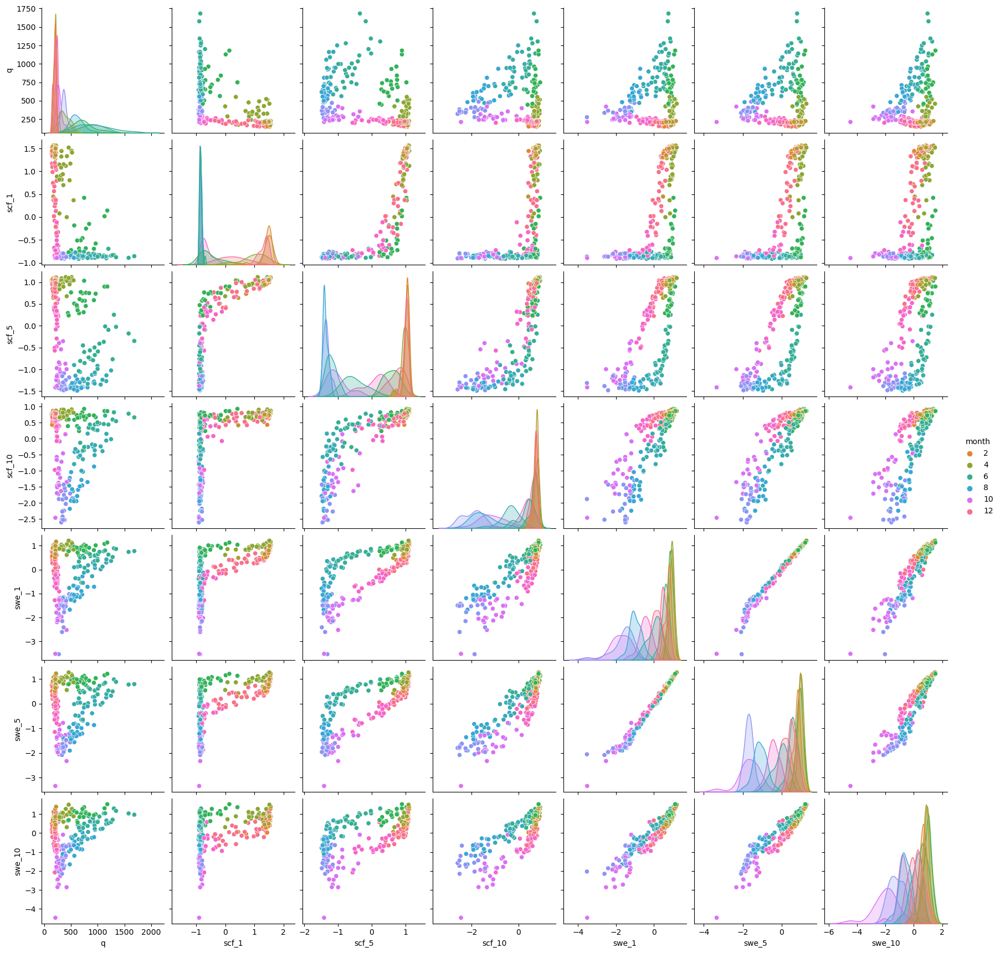

In [25]:
# add month column to prep_data
prep_data['month'] = prep_data['date'].dt.month

sns.pairplot(prep_data, vars=['q', 'scf_1', 'scf_5', 'scf_10', 'swe_1', 'swe_5', 'swe_10'], diag_kind='kde', hue='month', palette='husl')   

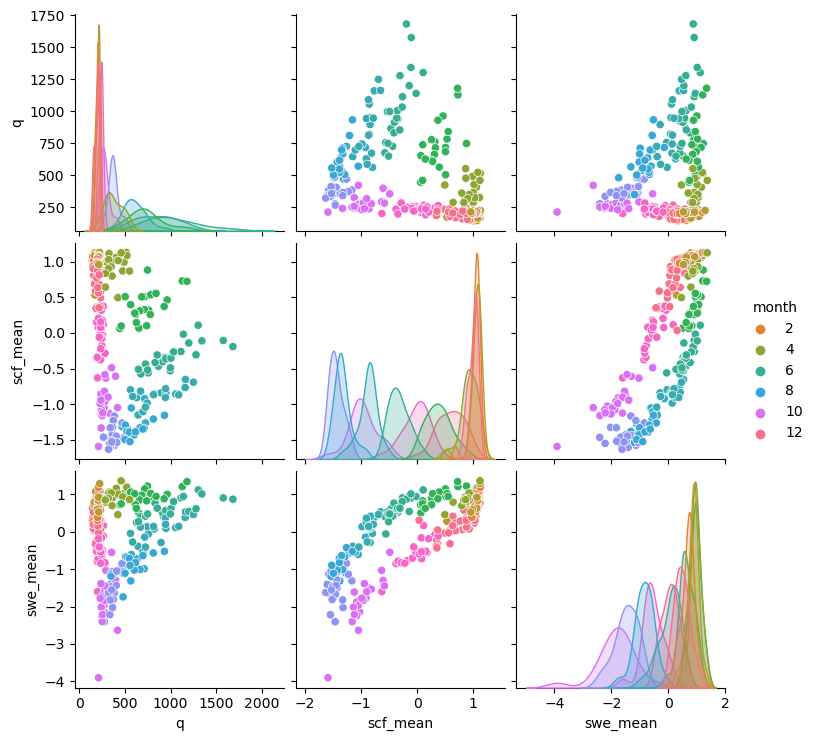

In [22]:
sns.pairplot(prep_data, vars=['q', 'scf_mean', 'swe_mean'], diag_kind='kde', hue='month', palette='husl')   

## 3.4 Further Relevant EDA Stuff
EDA with correlation analysis as provided by pycaret.

### 3.4.1 ACF and PACF for Time Series Modeling

In [27]:
from pycaret.time_series import TSForecastingExperiment
eda = TSForecastingExperiment()

prep_data_ocean_idx = prep_data.copy()
prep_data_ocean_idx = prep_data_ocean_idx[['date','q','month','index_NAO', 'index_PDO', 'd_q', 'd_d_q']]

eda.setup(data = prep_data_ocean_idx,
                    target = 'q',
                    fh = 6,
                    numeric_imputation_target = "ffill", 
                    numeric_imputation_exogenous = "ffill",
                    fig_kwargs = global_fig_settings, 
                    session_id = 123,
                    index = 'date')

,Description,Value
0,session_id,123
1,Target,q
2,Approach,Univariate
3,Exogenous Variables,Present
4,Original data shape,"(264, 6)"
5,Transformed data shape,"(264, 6)"
6,Transformed train set shape,"(258, 6)"
7,Transformed test set shape,"(6, 6)"
8,Rows with missing values,0.8%
9,Fold Generator,ExpandingWindowSplitter


The diagnostics plot is a good way to start eda for an experiment. It performs a few things automatically, including the ACF and PACF plots.

In [28]:
eda.plot_model(plot="diagnostics")

There is significant autocorrelation in the data. This is not surprising given that we are dealing with a time series with strong seasonality. Lets look into this further.

In [29]:
eda.plot_model(plot="diff", 
                fig_kwargs={"height": 1000, "width": 1200},
                data_kwargs={"lags_list": [1, [1, 12]],
                                "acf": True,
                                "pacf": True,
                                "periodogram": True,
                                "fft": True,
    })

The first row above shows raw data, the autocorrelation function, the PACF, and the periodogram. The second row shows the same for the first difference of the data. The third row shows the same for the first difference and the seasonal difference of 12. 

When working with seasonal time series data, taking the first difference is often done to remove the seasonal component and make the data stationary. Stationarity is an important assumption in many time series models because it simplifies the modeling process and allows for more accurate predictions.

The problem with autocorrelation in time series data is that it violates the assumption of independence. Autocorrelation refers to the correlation between observations at different time lags. If there is significant autocorrelation present, it means that the current value of a time series is related to its past values. This can lead to biased parameter estimates and unreliable model predictions.

A note on the FFT graph. Peaking at a frequency and its multiples is indicative of seasonality. The lowest frequency in this case is called the fundamental frequency and the inverse of this frequency is the seasonal period for the model. In this case, the fundamental frequency is 0.0833 and the seasonal period is 12.

(below is taken from the PyCaret Official documentation...)

**Observations:**

1. In the second row, we have only removed the wandering behavior by taking a first difference. This can be seen in the ACF plot (extended autocorrelations are gone) and Periodogram (peaking at f =~ 0 is squished). The ACF (preaking at seasonal period of 12 and its multiples) and PACF (peaking at fundamental frequency of 0.0833 and its multiples) still show the seasonal behavior.
2. In the third row, we have taken first difference followed by a seasonal difference of 12. Now, we can see that the peaking at seasonal multiples is gone from both ACF and Periodogram. There is still a little bit of autoregresssive properties that we have not taken care of but by looking at the PACF, maybe p=1 seems like a reasonable value to use (most lags after that are insignificant).

**Conclusion**
* If you were modeling this with ARIMA, the model to try would be **ARIMA(1,1,0)x(0,1,0,12)**.
* Other models could use this information appropriately. For example, reduced regression models could remove the trend and seasonality of 12 (i.e. make the data stationary) before modeling the rest of the autoregressive properties. Luckily, the `pycaret` time series module will take care of this internally.

Another classical eda plot is the time series decomposition. Let us look at it!

In [30]:
eda.plot_model(plot="decomp_stl", data_kwargs={"seasonal_period": 12})

In [31]:
# Show the Cross Validation splits inside the train set
# The blue dots represent the training data for each fold.
# The orange dots represent the validation data for each fold
eda.plot_model(plot="cv", fig_kwargs={"height": 400, "width": 900})

### 3.4.2 Statistical Tests
Statistical Testing is another important part of time series modeling. This can be achieved easily in pycaret using check_stats.
Options are:
'summary',
'white_noise'
'stationarity'
'adf'
'kpss'
'normality'
'all'
By default the statistics are run on the "transformed" data, but similar to plots, the user has the abiliy to set this to another data type using the data_type argument. e.g. eda.check_stats(test="summary", data_type = "original")

In [32]:
# Summary Statistics
eda.check_stats(test="summary")

,Test,Test Name,Data,Property,Setting,Value
0,Summary,Statistics,Transformed,Length,,264.000000
1,Summary,Statistics,Transformed,# Missing Values,,0.000000
2,Summary,Statistics,Transformed,Mean,,439.279924
3,Summary,Statistics,Transformed,Median,,289.000000
4,Summary,Statistics,Transformed,Standard Deviation,,306.826404
5,Summary,Statistics,Transformed,Variance,,94142.442219
6,Summary,Statistics,Transformed,Kurtosis,,1.450411
7,Summary,Statistics,Transformed,Skewness,,1.387589
8,Summary,Statistics,Transformed,# Distinct Values,,205.000000


In [33]:
# Stationarity tests (ADF and KPSS)
# NOTE: Users can also just run a single test by passing either 'adf' or 'kpss' to `check_stats`
eda.check_stats(test='stationarity')

,Test,Test Name,Data,Property,Setting,Value
0,Stationarity,ADF,Transformed,Stationarity,{'alpha': 0.05},True
1,Stationarity,ADF,Transformed,p-value,{'alpha': 0.05},0.036499
2,Stationarity,ADF,Transformed,Test Statistic,{'alpha': 0.05},-2.983144
3,Stationarity,ADF,Transformed,Critical Value 1%,{'alpha': 0.05},-3.456781
4,Stationarity,ADF,Transformed,Critical Value 5%,{'alpha': 0.05},-2.873172
5,Stationarity,ADF,Transformed,Critical Value 10%,{'alpha': 0.05},-2.572969
6,Stationarity,KPSS,Transformed,Trend Stationarity,{'alpha': 0.05},True
7,Stationarity,KPSS,Transformed,p-value,{'alpha': 0.05},0.1
8,Stationarity,KPSS,Transformed,Test Statistic,{'alpha': 0.05},0.019286
9,Stationarity,KPSS,Transformed,Critical Value 10%,{'alpha': 0.05},0.119


Tests confirm stationarity of data.

In [34]:
# Ljung-Bx test to tests of white noise (whether the data is uncorrelated or not)
eda.check_stats(test='white_noise')

,Test,Test Name,Data,Property,Setting,Value
0,White Noise,Ljung-Box,Transformed,Test Statictic,"{'alpha': 0.05, 'K': 24}",1497.432768
1,White Noise,Ljung-Box,Transformed,Test Statictic,"{'alpha': 0.05, 'K': 48}",2755.703035
2,White Noise,Ljung-Box,Transformed,p-value,"{'alpha': 0.05, 'K': 24}",0.0
3,White Noise,Ljung-Box,Transformed,p-value,"{'alpha': 0.05, 'K': 48}",0.0
4,White Noise,Ljung-Box,Transformed,White Noise,"{'alpha': 0.05, 'K': 24}",False
5,White Noise,Ljung-Box,Transformed,White Noise,"{'alpha': 0.05, 'K': 48}",False


The Ljung-Box tests indicates that the data is not white noise - again something that was clearly visible in the data

In [35]:
# Perform all tests together
eda.check_stats()

,Test,Test Name,Data,Property,Setting,Value
0,Summary,Statistics,Transformed,Length,,264.0
1,Summary,Statistics,Transformed,# Missing Values,,0.0
2,Summary,Statistics,Transformed,Mean,,439.279924
3,Summary,Statistics,Transformed,Median,,289.0
4,Summary,Statistics,Transformed,Standard Deviation,,306.826404
5,Summary,Statistics,Transformed,Variance,,94142.442219
6,Summary,Statistics,Transformed,Kurtosis,,1.450411
7,Summary,Statistics,Transformed,Skewness,,1.387589
8,Summary,Statistics,Transformed,# Distinct Values,,205.0
9,White Noise,Ljung-Box,Transformed,Test Statictic,"{'alpha': 0.05, 'K': 24}",1497.432768


### 3.4.3 Cross Correlation Functions
Next, let us explore cross correlation functions between the target variable and the exogenous variables.

In [36]:
eda.plot_model(plot="ccf", 
                fig_kwargs={"height": 1000, "width": 1200}
    )

# 4 BASELINE MODELS

## 4.0 Quickstart

In [37]:
# Load prep_data from csv file
prep_data = pd.read_csv('./data/prep_data.csv')
prep_data['date'] = pd.to_datetime(prep_data['date']) # make sure that the date column is of type datetime

In [38]:
prep_data.dtypes

date            datetime64[ns]
q                      float64
scf_1                  float64
scf_2                  float64
scf_3                  float64
                     ...      
d_d_swe_7              float64
d_d_swe_8              float64
d_d_swe_9              float64
d_d_swe_10             float64
d_d_swe_mean           float64
Length: 72, dtype: object

## 4.1 Modeling Helper Functions & Config Files
Here, we define the ignore_feature_list which we can use to easily exclude features from selected models. The ignore_feature_list contains all features except the basic ones (q, month, year, date). The create_feature_list function takes all available features and just spits out the list that are not contained in the ignore_feature_list. This is useful for the model setup since the PyCaret setup(function) does allow for excluding features in a straight forward manner. The inverse of the list then helps us to easily keep track of the features that are actually used in the model.

In [39]:
# get the column names from prep_data dataframe
prep_data_names = prep_data.columns.to_list()
prep_data_names
# select the columns that contain the string 'scf' and 'swe'
ignore_feature_list = [s for s in prep_data_names if 'scf' in s or 'swe' in s or 'index' in s or 'd_' in s or 'lag' in s]
# concatenate the list of columns with the string 'date
#ignore_feature_list = ['date'] + ignore_feature_list
print(ignore_feature_list)

#create a function that takes a list of features to ignore and returns a list of features to use from a base list
def create_feature_list(base_list, ignore_list):
    # this function takes a list of features to ignore and returns a list of features to use from a base list
    feature_list = [x for x in base_list if x not in ignore_list]
    return feature_list

# testing function
create_feature_list(prep_data_names, ignore_feature_list)


['scf_1', 'scf_2', 'scf_3', 'scf_4', 'scf_5', 'scf_6', 'scf_7', 'scf_8', 'scf_9', 'scf_10', 'scf_mean', 'swe_1', 'swe_2', 'swe_3', 'swe_4', 'swe_5', 'swe_6', 'swe_7', 'swe_8', 'swe_9', 'swe_10', 'swe_mean', 'index_NAO', 'index_PDO', 'd_q', 'd_d_q', 'd_scf_1', 'd_scf_2', 'd_scf_3', 'd_scf_4', 'd_scf_5', 'd_scf_6', 'd_scf_7', 'd_scf_8', 'd_scf_9', 'd_scf_10', 'd_scf_mean', 'd_d_scf_1', 'd_d_scf_2', 'd_d_scf_3', 'd_d_scf_4', 'd_d_scf_5', 'd_d_scf_6', 'd_d_scf_7', 'd_d_scf_8', 'd_d_scf_9', 'd_d_scf_10', 'd_d_scf_mean', 'd_swe_1', 'd_swe_2', 'd_swe_3', 'd_swe_4', 'd_swe_5', 'd_swe_6', 'd_swe_7', 'd_swe_8', 'd_swe_9', 'd_swe_10', 'd_swe_mean', 'd_d_swe_1', 'd_d_swe_2', 'd_d_swe_3', 'd_d_swe_4', 'd_d_swe_5', 'd_d_swe_6', 'd_d_swe_7', 'd_d_swe_8', 'd_d_swe_9', 'd_d_swe_10', 'd_d_swe_mean']


['date', 'q']

## 4.2 Baseline Time Series Model
The Time Series Module is a dedicated for forecasting and includes a combination of statistical and regression based models. For regression based models in the time series module, the feature engineering is done automatically. This is a huge advantage as it saves a lot of time and effort in preparing the data for modeling when compared to the traditional regression models.

More information collected from various sources on the internet:

PyCaret Time Series Forecasting module has a rich set of models ranging from traditional statistical models such as ARIMA, Exponential Smoothing, ETS, etc to 'Reduced Regression Models'.

Usually, we can not use a regression model directly to build a forecasting model for data with temporal dependence (fancy term for time series data). In order to do so, we need to first convert the temporal data into a supervised learning problem with appropriate features. For the sake of this discussion, we will call his "reduced regression". An important concern during this process is to make sure that we do not leak information about any future (unavailable) data while performing this conversion. Another important concern here is the ability to do multi-step ahead forecasting using this approach. Since the data is formulated as a single step ahead supervised problem, performing multi-step ahead forecasting needs addition work which the modeler must take care of.

The **sktime library** provides a very convenient way to perform Time Series Forecasting using Reduced Regression models and PyCaret has incorporated the same into its time series module as well. However, there are some nuances that need to be taken into consideration when using these models. For example, since the Reduced Regression models do not have any notion of time, trends, and seasonality, it is often useful to deseasonalize and de-trend the data before performing the reduction, training and forecasting. This is analogous to modeling only the auto-regressive terms in the data which makes it easier to find a better fitting model since we are not relying on it to figure out seasonality and trend in addition to the auto-regressive properties.

This is taken care of automatically in PyCaret using a pipeline which conditionally deseasonalizes (if seasonality is detected) and de-trends the data before fitting it. These models are represented with a suffix _cds_dt. The time series module currently supports almost 20 reduced regression models of various types (linear, decision trees, gradient boosted, nearest neighbors, etc)! The full list of models supported can be found below.

In [40]:
# Data preparation
bl_feature_list = create_feature_list(prep_data_names, ignore_feature_list)
prep_data_bl = prep_data.copy()
prep_data_bl = prep_data_bl[bl_feature_list]
# reset index 
prep_data_bl.set_index('date', inplace=True)
prep_data_bl.index = prep_data_bl.index.to_period(freq='M') # convert index to period index. PyCaret works best with period indices. See
# https://github.com/pycaret/pycaret/issues/3417#issuecomment-1476394446
prep_data_bl.head()

,q
date,
2001-01,173.0
2001-02,169.0
2001-03,202.0
2001-04,329.0
2001-05,761.0


In [41]:
# Setting up experiment
from pycaret.time_series import TSForecastingExperiment
exp_bl = TSForecastingExperiment()
exp_bl.setup(data=prep_data_bl,
                    target = 'q',
                    fh = 6,
                    #scale_target='zscore',
                    numeric_imputation_target = "ffill",
                    numeric_imputation_exogenous = "ffill", 
                    fig_kwargs = global_fig_settings, 
                    session_id = 123,
                    log_experiment = False,
                    experiment_name = 'ts_uni_bl_scaled_target_demo',
                    log_plots = True,
                    log_data = True,
                    profile = False
                    )

# Note, scaling and transformation leads to deterioration of performance across all models.

,Description,Value
0,session_id,123
1,Target,q
2,Approach,Univariate
3,Exogenous Variables,Not Present
4,Original data shape,"(264, 1)"
5,Transformed data shape,"(264, 1)"
6,Transformed train set shape,"(258, 1)"
7,Transformed test set shape,"(6, 1)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


In [42]:
# Check available models in the time series module and in our installation
exp_bl.models()

,Name,Reference,Turbo
ID,,,
naive,Naive Forecaster,sktime.forecasting.naive.NaiveForecaster,True
grand_means,Grand Means Forecaster,sktime.forecasting.naive.NaiveForecaster,True
snaive,Seasonal Naive Forecaster,sktime.forecasting.naive.NaiveForecaster,True
polytrend,Polynomial Trend Forecaster,sktime.forecasting.trend.PolynomialTrendForeca...,True
arima,ARIMA,sktime.forecasting.arima.ARIMA,True
auto_arima,Auto ARIMA,sktime.forecasting.arima.AutoARIMA,True
exp_smooth,Exponential Smoothing,sktime.forecasting.exp_smoothing.ExponentialSm...,True
ets,ETS,sktime.forecasting.ets.AutoETS,True
theta,Theta Forecaster,sktime.forecasting.theta.ThetaForecaster,True


In [43]:
# Compare all models
exp_bl_best = exp_bl.compare_models(turbo=False) # the turbo=False option gives us access to an even larger set of models!

,Model,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2,TT (Sec)
auto_arima,Auto ARIMA,0.6635,0.5376,62.5313,87.8773,0.1130,0.1171,0.8935,6.0167
tbats,TBATS,0.7386,0.5779,69.5726,94.4304,0.1373,0.1443,0.8806,3.9767
omp_cds_dt,Orthogonal Matching Pursuit w/ Cond. Deseasonalize & Detrending,0.7462,0.6063,70.3579,99.1986,0.1473,0.1540,0.8620,0.0433
et_cds_dt,Extra Trees w/ Cond. Deseasonalize & Detrending,0.7483,0.6227,70.5540,101.9290,0.1421,0.1455,0.8500,0.0833
huber_cds_dt,Huber w/ Cond. Deseasonalize & Detrending,0.7524,0.5922,70.9345,96.8683,0.1521,0.1627,0.8654,0.0500
br_cds_dt,Bayesian Ridge w/ Cond. Deseasonalize & Detrending,0.7531,0.5913,71.0071,96.7219,0.1548,0.1659,0.8633,0.0400
lasso_cds_dt,Lasso w/ Cond. Deseasonalize & Detrending,0.7684,0.5995,72.4517,98.0716,0.1577,0.1696,0.8611,0.0667
llar_cds_dt,Lasso Least Angular Regressor w/ Cond. Deseasonalize & Detrending,0.7684,0.5995,72.4519,98.0718,0.1577,0.1696,0.8611,0.0733
ridge_cds_dt,Ridge w/ Cond. Deseasonalize & Detrending,0.7685,0.5995,72.4586,98.0709,0.1578,0.1696,0.8610,0.0700
lr_cds_dt,Linear w/ Cond. Deseasonalize & Detrending,0.7685,0.5995,72.4586,98.0709,0.1578,0.1696,0.8610,0.0667


Processing:   0%|          | 0/133 [00:00<?, ?it/s]

In [44]:
exp_bl_best

AutoARIMA(random_state=123, sp=12, suppress_warnings=True)

In [45]:
# Interesting, Auto Arima beats in all performance indicator categories. 
# The **MAE** with the baseline time series model is 62.5 m3/s. 
# This is a significant improvement over the baseline regression model (Section 4.2.1 above).

# Plotting insample predictions
fig_kwargs = {"a": "Year", "b": "Discharge (m3/s)"}    
exp_bl.plot_model(exp_bl_best, plot = "insample", fig_kwargs = fig_kwargs)

In [46]:
# Plotting out of sample predictions
exp_bl.plot_model(exp_bl_best)

The following observations can be done:
- *predict_model()* is intelligent enough to understand the current state of the model (i.e. it is only trained using the train dataset).
- Since the model has only been trained on the train set so far, the predictions are made for the test set.
- Later, we will see that once the model is finalized (trained on the complete train + test set), predict_model automatically makes the true future predictions automatically.
- Also note that if the model supports prediction intervals, they are plotted by default for convenience (as is the case for Auto ARIMA as shown above).

Next, let's check the goodness of fit using both diagnostic plots and statistical tests. Similar to plot_model, passing an estimator to the check_stats call will perform the tests on the model residuals.

In [47]:
# Check Goodness of Fit
exp_bl.check_stats(exp_bl_best)

# Note: The residuals are stationary, yet, they are not normally distributed. 
# Next, we can plot the diagnostics on the residuals just like we did it on the original dataset.

,Test,Test Name,Data,Property,Setting,Value
0,Summary,Statistics,Residual,Length,,258.0
1,Summary,Statistics,Residual,# Missing Values,,0.0
2,Summary,Statistics,Residual,Mean,,-0.95035
3,Summary,Statistics,Residual,Median,,-8.747
4,Summary,Statistics,Residual,Standard Deviation,,118.789131
5,Summary,Statistics,Residual,Variance,,14110.857629
6,Summary,Statistics,Residual,Kurtosis,,10.752891
7,Summary,Statistics,Residual,Skewness,,1.802392
8,Summary,Statistics,Residual,# Distinct Values,,258.0
9,White Noise,Ljung-Box,Residual,Test Statictic,"{'alpha': 0.05, 'K': 24}",38.081321


In [48]:
# Diagnostics on residuals
exp_bl.plot_model(exp_bl_best, plot='diagnostics', fig_kwargs={"height": 800, "width": 1000})

In [49]:
# Finalize baseline time series model
exp_bl_final = exp_bl.finalize_model(exp_bl_best)
exp_bl.predict_model(exp_bl_final, return_pred_int=True)

,y_pred,lower,upper
2023-01,215.8049,34.4976,397.1121
2023-02,216.1951,0.0990,432.2913
2023-03,224.8334,-4.3217,453.9885
2023-04,387.7568,153.3267,622.1870
2023-05,734.3235,497.7099,970.9371
2023-06,883.8493,646.3235,1121.3752


In [27]:
exp_bl_final

ForecastingPipeline(steps=[('forecaster',
                            TransformedTargetForecaster(steps=[('transformer_target',
                                                                TransformerPipeline(steps=[('numerical_imputer',
                                                                                            Imputer(method='ffill',
                                                                                                    random_state=123)),
                                                                                           ('transformer',
                                                                                            BoxCoxTransformer()),
                                                                                           ('scaler',
                                                                                            TabularToSeriesAdaptor(transformer=StandardScaler()))])),
                                                               ('model',
                                                                AutoARIMA(random_state=123,
                                                                          sp=12,
                                                                          suppress_warnings=True))]))])

# 5 MODEL EXPERIMENTS
Here, we experiment with different types of models with different features to see if adding/removing features improves the model performance.

## 5.0 Prediction Wrapper for Forecasting with External Regressors
When we deal with external regressors, we need to pass them to PyCaret for prediction. This is done via the predict_model() function. The below wrapper function provides a wrapper for safe predictions and warns you, when you have not passed the external regressors correctly. This is just for demo purposes and not needed in the actual workflow later.

In [69]:
def safe_predict(exp, model):
    """Prediction wrapper for demo purposes."""
    try: 
        exp.predict_model(model)
    except ValueError as exception:
        print(exception)
        exo_vars = exp.exogenous_variables
        print(f"{len(exo_vars)} exogenous variables (X) needed in order to make future predictions:\n{exo_vars}")

## 5.1 Experiment with External Regressors

We set up a generic experiment pipeline here that works with any type of external regressors. We can then do several assessments with this code, log them in MLflow and then compare the results. This is the idea here (see also Section 6 below).

IMPORTANT note before we start. As per @ngupta23 and his post in reply to the filed issue #3548, best practices are:

1. Since we are using a mix of statistical and regression models in 'compare_models', the features extracted from date such as week number, etc. should only be provided to the regression-based models. The statistical models already have a notion of time and can derive it automatically.
2. In pycaret time series module, you do **not** have to provide these date features (such month, year, etc.) since it has internal mechanisms to take care of that through deseasonalizing and detrending. It also takes into account prior lags appropriately for these regression models.
3. One has the choice to manually provide these features as well. e.g. prior lagged values + other features that we create, such as rolling mean values. For this, you would use the 'fe_target_rr'  argument as shown below.

More details can be found here: https://github.com/pycaret/pycaret/issues/3548 

### 5.1.1 Prepare Experiment Model Data

In [70]:
# forecast horizon
exp_fh = 6

# define feature list
exp_feature_list = ['date', 'q', 'scf_mean', 'swe_mean']

# prepare the data
prep_data_exp = prep_data.copy()
prep_data_exp = prep_data_exp[exp_feature_list]
prep_data_exp.set_index('date', inplace=True)
prep_data_exp.index = prep_data_exp.index.to_period(freq='M') # period index is appreciated by PyCaret under the hood.
print('Prepared data for experiment:')
print(prep_data_exp.tail())

Prepared data for experiment:
             q  scf_mean  swe_mean
date                              
2022-08  556.0 -1.525259 -0.898425
2022-09  356.0 -1.529392 -1.554869
2022-10  240.0 -1.333956       NaN
2022-11  235.0  0.153997       NaN
2022-12  219.0  0.812841       NaN


In [71]:
prep_data_exp.tail()

,q,scf_mean,swe_mean
date,,,
2022-08,556.0,-1.525259,-0.898425
2022-09,356.0,-1.529392,-1.554869
2022-10,240.0,-1.333956,NaN
2022-11,235.0,0.153997,NaN
2022-12,219.0,0.812841,NaN


### 5.1.2 Setup Experiment
The experiment is set up here. The setup() function initializes the training environment and creates the transformation pipeline. Setup function must be called before executing any other function. It takes two mandatory parameters: data and target. All the other parameters are optional.

Please note that the user should decide at this stage whether to log experiments or not in MLFlow (all open source). The user should also select a good name for the experiment so that the user can understand what the experiment is about.

In [74]:
# For the target variable: Take last 6 lags and the mean of the last [6,12] months as features (rolling long lag features)
kwargs = {"lag_feature": {"lag": [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12], "mean": [[6, 6]]}}
fe_target_rr = [WindowSummarizer(n_jobs=1, truncate="bfill", **kwargs)]

from pycaret.time_series import TSForecastingExperiment
exp = TSForecastingExperiment()
exp.setup(data = prep_data_exp,
                    target = 'q',
                    fh = exp_fh,
                    fe_target_rr =  fe_target_rr,
                    numeric_imputation_target = "ffill",
                    numeric_imputation_exogenous = "ffill", 
                    fig_kwargs = global_fig_settings, 
                    session_id = 123,
                    log_experiment = "dagshub",
                    log_plots = True,
                    log_data = True,
                    profile = False,
                    experiment_name = 'monthly_exp_llag_roll_xreg_scf_swe')
exp

,Description,Value
0,session_id,123
1,Target,q
2,Approach,Univariate
3,Exogenous Variables,Present
4,Original data shape,"(264, 3)"
5,Transformed data shape,"(264, 3)"
6,Transformed train set shape,"(258, 3)"
7,Transformed test set shape,"(6, 3)"
8,Rows with missing values,1.5%
9,Fold Generator,ExpandingWindowSplitter


2023/06/15 15:34:24 INFO mlflow.tracking.fluent: Experiment with name 'monthly_exp_llag_roll_xreg_scf_swe' does not exist. Creating a new experiment.


Uploading files (2) to "tobiassiegfried/pycaret_3_forecasting"...

Upload finished successfully!

In [75]:
# Which are the exogenous variables?
x_regs = exp.exogenous_variables
x_regs

['scf_mean', 'swe_mean']

### 5.1.3 Auto Compare, Tune, and Blend Models
Let us keep the 3 best models, then tune them and also look at a blended model and how it performs. 

A note on model blending (copied from https://colab.research.google.com/github/pycaret/pycaret/blob/master/tutorials/time_series/forecasting/univariate_without_exogeneous_part3.ipynb#scrollTo=UC-PXNsu41xB ). Sometimes, we can achieve even better results if we combine results of several good models. This can be achieved using the blend_model functionality. There are several options available to blend such as the mean, gmean median, min, max. In addition, weights can be applied to the forecasts from the base learners. This is useful when we want to give more importance (weight) to models with a lower error for example. Please refer to the blend_models docstring for more information about the blending functionality.


In [76]:
# Compare models
best_models = exp.compare_models(n_select=3, turbo=False)

,Model,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2,TT (Sec)
et_cds_dt,Extra Trees w/ Cond. Deseasonalize & Detrending,0.6836,0.5921,64.4490,96.8783,0.1254,0.1285,0.8667,0.0900
lightgbm_cds_dt,Light Gradient Boosting w/ Cond. Deseasonalize & Detrending,0.6881,0.5290,64.8768,86.5686,0.1562,0.1660,0.8960,0.0933
ada_cds_dt,AdaBoost w/ Cond. Deseasonalize & Detrending,0.7109,0.6091,67.0537,99.7399,0.1384,0.1348,0.8525,0.0667
omp_cds_dt,Orthogonal Matching Pursuit w/ Cond. Deseasonalize & Detrending,0.7462,0.6063,70.3579,99.1986,0.1473,0.1540,0.8620,0.0533
huber_cds_dt,Huber w/ Cond. Deseasonalize & Detrending,0.7466,0.5953,70.3929,97.3744,0.1489,0.1590,0.8663,0.0567
en_cds_dt,Elastic Net w/ Cond. Deseasonalize & Detrending,0.7527,0.5952,70.9755,97.3775,0.1518,0.1623,0.8645,0.0767
br_cds_dt,Bayesian Ridge w/ Cond. Deseasonalize & Detrending,0.7534,0.5915,71.0354,96.7460,0.1549,0.1660,0.8632,0.0767
lasso_cds_dt,Lasso w/ Cond. Deseasonalize & Detrending,0.7613,0.5997,71.7928,98.1110,0.1563,0.1671,0.8631,0.0533
llar_cds_dt,Lasso Least Angular Regressor w/ Cond. Deseasonalize & Detrending,0.7613,0.5997,71.7928,98.1110,0.1563,0.1671,0.8631,0.0767
ridge_cds_dt,Ridge w/ Cond. Deseasonalize & Detrending,0.7658,0.6019,72.2218,98.4765,0.1583,0.1690,0.8626,0.0767


Processing:   0%|          | 0/111 [00:00<?, ?it/s]

In sample predictions has not been implemented for this estimator of type 'BaseCdsDtForecaster' in `sktime`. When this is implemented, it will be enabled by default in pycaret.
In sample predictions has not been implemented for this estimator of type 'BaseCdsDtForecaster' in `sktime`. When this is implemented, it will be enabled by default in pycaret.
In sample predictions has not been implemented for this estimator of type 'BaseCdsDtForecaster' in `sktime`. When this is implemented, it will be enabled by default in pycaret.
In sample predictions has not been implemented for this estimator of type 'BaseCdsDtForecaster' in `sktime`. When this is implemented, it will be enabled by default in pycaret.
In sample predictions has not been implemented for this estimator of type 'BaseCdsDtForecaster' in `sktime`. When this is implemented, it will be enabled by default in pycaret.
In sample predictions has not been implemented for this estimator of type 'BaseCdsDtForecaster' in `sktime`. When t

In [77]:
best_models

[BaseCdsDtForecaster(fe_target_rr=[WindowSummarizer(lag_feature={'lag': [1, 2, 3,
                                                                         4, 5, 6,
                                                                         7, 8, 9,
                                                                         10, 11,
                                                                         12],
                                                                 'mean': [[6,
                                                                           6]]},
                                                    n_jobs=1,
                                                    truncate='bfill')],
                     regressor=ExtraTreesRegressor(n_jobs=-1, random_state=123),
                     sp=12, window_length=12),
 BaseCdsDtForecaster(fe_target_rr=[WindowSummarizer(lag_feature={'lag': [1, 2, 3,
                                                                         4, 5, 6,
          

In [78]:
# Store metrics for later comparison
compare_metrics = exp.pull()
compare_metrics

,Model,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2,TT (Sec)
et_cds_dt,Extra Trees w/ Cond. Deseasonalize & Detrending,0.6836,0.5921,64.449,96.8783,0.1254,0.1285,0.8667,0.0900
lightgbm_cds_dt,Light Gradient Boosting w/ Cond. Deseasonalize...,0.6881,0.529,64.8768,86.5686,0.1562,0.166,0.896,0.0933
ada_cds_dt,AdaBoost w/ Cond. Deseasonalize & Detrending,0.7109,0.6091,67.0537,99.7399,0.1384,0.1348,0.8525,0.0667
omp_cds_dt,Orthogonal Matching Pursuit w/ Cond. Deseasona...,0.7462,0.6063,70.3579,99.1986,0.1473,0.154,0.862,0.0533
huber_cds_dt,Huber w/ Cond. Deseasonalize & Detrending,0.7466,0.5953,70.3929,97.3744,0.1489,0.159,0.8663,0.0567
en_cds_dt,Elastic Net w/ Cond. Deseasonalize & Detrending,0.7527,0.5952,70.9755,97.3775,0.1518,0.1623,0.8645,0.0767
br_cds_dt,Bayesian Ridge w/ Cond. Deseasonalize & Detren...,0.7534,0.5915,71.0354,96.746,0.1549,0.166,0.8632,0.0767
lasso_cds_dt,Lasso w/ Cond. Deseasonalize & Detrending,0.7613,0.5997,71.7928,98.111,0.1563,0.1671,0.8631,0.0533
llar_cds_dt,Lasso Least Angular Regressor w/ Cond. Deseaso...,0.7613,0.5997,71.7928,98.111,0.1563,0.1671,0.8631,0.0767
ridge_cds_dt,Ridge w/ Cond. Deseasonalize & Detrending,0.7658,0.6019,72.2218,98.4765,0.1583,0.169,0.8626,0.0767


In [79]:
# Tuning best models
best_tuned_models = [exp.tune_model(model) for model in best_models]

,cutoff,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2
0,2020-12,0.9787,0.8004,92.8244,131.9777,0.1841,0.1809,0.7682
1,2021-06,0.3616,0.2656,34.0759,43.4436,0.1009,0.0963,0.9490
2,2021-12,1.0815,0.8539,101.3858,138.6186,0.2141,0.2476,0.8340
Mean,NaT,0.8073,0.6400,76.0954,104.6800,0.1664,0.1749,0.8504
SD,NaT,0.3179,0.2656,29.9171,43.3854,0.0479,0.0619,0.0747


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 3 folds for each of 10 candidates, totalling 30 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=-1)]: Done  30 out of  30 | elapsed:    1.6s finished


In sample predictions has not been implemented for this estimator of type 'BaseCdsDtForecaster' in `sktime`. When this is implemented, it will be enabled by default in pycaret.
In sample predictions has not been implemented for this estimator of type 'BaseCdsDtForecaster' in `sktime`. When this is implemented, it will be enabled by default in pycaret.
In sample predictions has not been implemented for this estimator of type 'BaseCdsDtForecaster' in `sktime`. When this is implemented, it will be enabled by default in pycaret.
In sample predictions has not been implemented for this estimator of type 'BaseCdsDtForecaster' in `sktime`. When this is implemented, it will be enabled by default in pycaret.


,cutoff,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2
0,2020-12,0.8892,0.7473,84.3280,123.2143,0.1490,0.1423,0.7980
1,2021-06,0.3266,0.2057,30.7752,33.6493,0.1132,0.1180,0.9694
2,2021-12,1.2525,0.9700,117.4182,157.4635,0.2080,0.2399,0.7858
Mean,NaT,0.8227,0.6410,77.5072,104.7757,0.1567,0.1667,0.8511
SD,NaT,0.3809,0.3209,35.6992,52.2014,0.0391,0.0527,0.0838


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 3 folds for each of 10 candidates, totalling 30 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=-1)]: Done  30 out of  30 | elapsed:    0.9s finished


In sample predictions has not been implemented for this estimator of type 'BaseCdsDtForecaster' in `sktime`. When this is implemented, it will be enabled by default in pycaret.
In sample predictions has not been implemented for this estimator of type 'BaseCdsDtForecaster' in `sktime`. When this is implemented, it will be enabled by default in pycaret.
In sample predictions has not been implemented for this estimator of type 'BaseCdsDtForecaster' in `sktime`. When this is implemented, it will be enabled by default in pycaret.
In sample predictions has not been implemented for this estimator of type 'BaseCdsDtForecaster' in `sktime`. When this is implemented, it will be enabled by default in pycaret.


,cutoff,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2
0,2020-12,0.9550,0.8725,90.5707,143.8635,0.1648,0.1445,0.7246
1,2021-06,0.3570,0.2205,33.6459,36.0670,0.1105,0.1082,0.9649
2,2021-12,0.7550,0.6599,70.7811,107.1203,0.1068,0.1204,0.9009
Mean,NaT,0.6890,0.5843,64.9992,95.6836,0.1274,0.1243,0.8634
SD,NaT,0.2485,0.2715,23.5963,44.7446,0.0265,0.0151,0.1016


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 3 folds for each of 10 candidates, totalling 30 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=-1)]: Done  30 out of  30 | elapsed:    2.1s finished


In sample predictions has not been implemented for this estimator of type 'BaseCdsDtForecaster' in `sktime`. When this is implemented, it will be enabled by default in pycaret.
In sample predictions has not been implemented for this estimator of type 'BaseCdsDtForecaster' in `sktime`. When this is implemented, it will be enabled by default in pycaret.
In sample predictions has not been implemented for this estimator of type 'BaseCdsDtForecaster' in `sktime`. When this is implemented, it will be enabled by default in pycaret.
In sample predictions has not been implemented for this estimator of type 'BaseCdsDtForecaster' in `sktime`. When this is implemented, it will be enabled by default in pycaret.


In [66]:
best_tuned_models[0]

BaseCdsDtForecaster(fe_target_rr=[WindowSummarizer(lag_feature={'lag': [1, 2, 3,
                                                                        4, 5, 6,
                                                                        7, 8, 9,
                                                                        10, 11,
                                                                        12],
                                                                'mean': [[6,
                                                                          6]]},
                                                   n_jobs=1,
                                                   truncate='bfill')],
                    regressor=ExtraTreesRegressor(n_jobs=-1, random_state=123),
                    sp=12, window_length=12)

In [80]:
# Blending with performance optimized weights
## Get model weights to use
top_model_metrics = compare_metrics.iloc[0:3]['MAE']
display(top_model_metrics)
top_model_weights = 1 - top_model_metrics/top_model_metrics.sum()
display(top_model_weights)

## Blend models
blended_model = exp.blend_models(best_tuned_models, method='mean', weights=top_model_weights.values.tolist())
y_predict = exp.predict_model(blended_model)
print(y_predict)

et_cds_dt           64.449
lightgbm_cds_dt    64.8768
ada_cds_dt         67.0537
Name: MAE, dtype: object

et_cds_dt          0.671814
lightgbm_cds_dt    0.669636
ada_cds_dt          0.65855
Name: MAE, dtype: object

,cutoff,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2
0,2020-12,0.8772,0.7825,83.1974,129.0287,0.1511,0.1386,0.7785
1,2021-06,0.2825,0.1791,26.6206,29.3014,0.0920,0.0923,0.9768
2,2021-12,0.8350,0.6893,78.2784,111.9045,0.1519,0.1700,0.8918
Mean,NaT,0.6649,0.5503,62.6988,90.0782,0.1316,0.1336,0.8824
SD,NaT,0.2710,0.2652,25.5900,43.5406,0.0280,0.0319,0.0813


Processing:   0%|          | 0/6 [00:00<?, ?it/s]

In sample predictions has not been implemented for this estimator of type 'EnsembleForecaster' in `sktime`. When this is implemented, it will be enabled by default in pycaret.
In sample predictions has not been implemented for this estimator of type 'EnsembleForecaster' in `sktime`. When this is implemented, it will be enabled by default in pycaret.
In sample predictions has not been implemented for this estimator of type 'EnsembleForecaster' in `sktime`. When this is implemented, it will be enabled by default in pycaret.
In sample predictions has not been implemented for this estimator of type 'EnsembleForecaster' in `sktime`. When this is implemented, it will be enabled by default in pycaret.


,Model,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2
0,EnsembleForecaster,0.2243,0.1481,21.0818,24.0078,0.0586,0.0572,0.9878


           y_pred
2022-07  839.0070
2022-08  594.9003
2022-09  365.5981
2022-10  270.6095
2022-11  226.6709
2022-12  205.9531


In [81]:
# Final Model List
# add blended_model to best_tuned_models to create a final list of models
best_tuned_models.append(blended_model)
exp.plot_model(estimator = best_tuned_models)

### 5.1.4 Finalize Model and Predict
We train the model on the complete dataset (train + test) and then make predictions on the future_df dataframe. This is the final model that we will use for the final predictions. Note that we need to pass future exogenous variables for forecasting as the safe_predict() warns us.

#### Known Future Values of External Regressors

Sometimes, we are in the fortunate position to work with an experiment where future external regressor variables are known. This is for example the case with the regressor set ['date', 'year', 'month', 'series', 'q_lag_roll_6', 'q_lag_roll_12']. The former three predictors can easily be extended from the data of forecasting into the future for the number of exp_fh steps. The long lagged variables by their nature are already available in the future dataframe. So, we can pass these regressors to the predict_model() function without the need for them to be predicted themselves. Note that such situation is the exception rather than the rule. In most cases, we will have to predict the external regressors first before we can use them in the predict_model() function. This is what we do in the next section below.


In [82]:
final_model = exp.finalize_model(best_tuned_models[0])
safe_predict(exp, final_model)

In sample predictions has not been implemented for this estimator of type 'ForecastingPipeline' in `sktime`. When this is implemented, it will be enabled by default in pycaret.
In sample predictions has not been implemented for this estimator of type 'ForecastingPipeline' in `sktime`. When this is implemented, it will be enabled by default in pycaret.
In sample predictions has not been implemented for this estimator of type 'ForecastingPipeline' in `sktime`. When this is implemented, it will be enabled by default in pycaret.
In sample predictions has not been implemented for this estimator of type 'ForecastingPipeline' in `sktime`. When this is implemented, it will be enabled by default in pycaret.
Model was trained with exogenous variables but you have not passed any for predictions. Please pass exogenous variables to make predictions.
2 exogenous variables (X) needed in order to make future predictions:
['scf_mean', 'swe_mean']


In [ ]:
pred_known_x_reg = exp.predict_model(final_model, fh = exp_fh, X = x_reg_data_exp)
# change column name from Label to q_pred_known_x_reg
pred_known_x_reg.rename(columns={'y_pred':'q_pred_known_x_reg'}, inplace=True)
pred_known_x_reg

,q_pred_known_x_reg
2023-01,196.6660
2023-02,188.4316
2023-03,208.7768
2023-04,402.8932
2023-05,742.6616
2023-06,1027.4327


#### Unknown Future Values of External Regressors
Most often, the external regressors themselves have to be predicted first before they can be used in the predict_model() function. The approach is shown here.

In [ ]:
# Get future values of exogenous variables x_regs via forecasting

# STEP 1: Train models for x_reg variables ----
x_exps = []
x_models = []
for x_reg in x_regs:
    x_exp = TSForecastingExperiment()
    x_exp.setup(
        data = prep_data_exp[x_reg], fh = exp_fh,
        numeric_imputation_target = "ffill", numeric_imputation_exogenous = "ffill",
        fig_kwargs = global_fig_settings, session_id = 123
    )

    # Users can customize how to model future exogenous variables i.e. add
    # more steps and models to potentially get better models at the expense
    # of higher modeling time.
    best = x_exp.compare_models(sort="mase", include=["arima", "ets", "exp_smooth", "theta", "lightgbm_cds_dt"])
    final_x_model = x_exp.finalize_model(best)

    x_exps.append(x_exp)
    x_models.append(final_x_model)

,Description,Value
0,session_id,123
1,Target,month
2,Approach,Univariate
3,Exogenous Variables,Not Present
4,Original data shape,"(264, 1)"
5,Transformed data shape,"(264, 1)"
6,Transformed train set shape,"(258, 1)"
7,Transformed test set shape,"(6, 1)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


,Model,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2,TT (Sec)
lightgbm_cds_dt,Light Gradient Boosting w/ Cond. Deseasonalize & Detrending,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,1.0000,0.4800
theta,Theta Forecaster,3.3333,0.0000,0.0000,0.0000,0.0000,0.0000,1.0000,0.3933
exp_smooth,Exponential Smoothing,10.5000,0.0000,0.0000,0.0000,0.0000,0.0000,1.0000,0.3900
arima,ARIMA,21854989802.0833,325.6647,0.0000,0.0000,0.0000,0.0000,1.0000,0.7567
ets,ETS,965055668311.6666,15944.5954,0.0002,0.0002,0.0001,0.0001,1.0000,0.4600


Processing:   0%|          | 0/25 [00:00<?, ?it/s]

,Description,Value
0,session_id,123
1,Target,year
2,Approach,Univariate
3,Exogenous Variables,Not Present
4,Original data shape,"(264, 1)"
5,Transformed data shape,"(264, 1)"
6,Transformed train set shape,"(258, 1)"
7,Transformed test set shape,"(6, 1)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


,Model,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2,TT (Sec)
ets,ETS,0.0024,0.0029,0.0024,0.0029,0.0000,0.0000,0.0000,0.4967
exp_smooth,Exponential Smoothing,0.0041,0.0043,0.0041,0.0043,0.0000,0.0000,0.0000,0.4133
theta,Theta Forecaster,0.1033,0.1250,0.1033,0.1250,0.0001,0.0001,0.0000,0.3967


Processing:   0%|          | 0/25 [00:00<?, ?it/s]

,Description,Value
0,session_id,123
1,Target,q_lag_roll_6
2,Approach,Univariate
3,Exogenous Variables,Not Present
4,Original data shape,"(264, 1)"
5,Transformed data shape,"(264, 1)"
6,Transformed train set shape,"(258, 1)"
7,Transformed test set shape,"(6, 1)"
8,Rows with missing values,4.2%
9,Fold Generator,ExpandingWindowSplitter


,Model,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2,TT (Sec)
theta,Theta Forecaster,0.2611,0.2229,20.9744,25.3317,0.0498,0.0494,0.8497,0.0167
ets,ETS,0.2786,0.2299,22.3807,26.1155,0.0535,0.0530,0.8391,0.0333
exp_smooth,Exponential Smoothing,0.2861,0.2468,23.0316,28.0827,0.0567,0.0576,0.8229,0.3933
lightgbm_cds_dt,Light Gradient Boosting w/ Cond. Deseasonalize & Detrending,0.4016,0.3366,32.3933,38.3432,0.0796,0.0756,0.6632,0.1067
arima,ARIMA,0.4862,0.3815,39.3928,43.5710,0.1015,0.1023,0.4763,0.4100


Processing:   0%|          | 0/25 [00:00<?, ?it/s]

,Description,Value
0,session_id,123
1,Target,q_lag_roll_12
2,Approach,Univariate
3,Exogenous Variables,Not Present
4,Original data shape,"(264, 1)"
5,Transformed data shape,"(264, 1)"
6,Transformed train set shape,"(258, 1)"
7,Transformed test set shape,"(6, 1)"
8,Rows with missing values,8.7%
9,Fold Generator,ExpandingWindowSplitter


,Model,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2,TT (Sec)
exp_smooth,Exponential Smoothing,0.6015,0.4327,7.8277,10.1035,0.0198,0.0199,-5.7275,0.0300
ets,ETS,0.6017,0.4327,7.8292,10.1053,0.0198,0.0199,-5.7311,0.0200
theta,Theta Forecaster,0.8915,0.5799,11.5712,13.5391,0.0296,0.0291,-20.2497,0.0167
arima,ARIMA,1.0194,0.6728,13.2269,15.7016,0.0339,0.0330,-32.2348,0.0233
lightgbm_cds_dt,Light Gradient Boosting w/ Cond. Deseasonalize & Detrending,1.1199,0.6769,14.5636,15.8105,0.0370,0.0363,-25.0367,0.0367


Processing:   0%|          | 0/25 [00:00<?, ?it/s]

In [ ]:
# Step 2: Get future predictions for exog variables ----
x_reg_inferred_data_exp = [
    x_exp.predict_model(x_model)
    for x_exp, x_model in zip(x_exps, x_models)
]
x_reg_inferred_data_exp = pd.concat(x_reg_inferred_data_exp, axis=1) # long to wide list.
# rename columns of future_exog dataframe to match the names of the exog_vars dataframe
x_reg_inferred_data_exp.columns = x_regs
# drop index
x_reg_inferred_data_exp.reset_index(drop=True, inplace=True)
x_reg_inferred_data_exp

# Explanatory note on the above code:
# This is a Python list comprehension, which is a concise way to create lists based on 
# existing lists (or other iterable objects). Let's break it down:

# The variable future_x_regs is assigned the result of the list comprehension. In the list comprehension:
# x_exp.predict_model(x_model) is the operation performed for each item in the list. 
# predict_model is a function from the PyCaret library used to predict the output based on a given model.
# for x_exp, x_model in zip(x_exps, x_models) is the loop that iterates over two lists (x_exps and x_models) simultaneously. 
# zip(x_exps, x_models) pairs each element of x_exps with the corresponding element of x_models.
# The x_exp is assumed to be an experiment instance or a similar object with a method predict_model(), 
# and x_model is a model that can be used as an argument to x_exp.predict_model(). 
# In simple terms, this code is predicting results for each model in x_models using the corresponding experiment in x_exps and 
# storing all of these predictions in the list future_x_regs.

# Assuming x_exps and x_models have the same length, the resulting future_x_regs will be a list of prediction results, 
# where each prediction corresponds to a pair of x_exp and x_model.

,month,year,q_lag_roll_6,q_lag_roll_12
0,1.0,2023.0100,641.9767,387.5878
1,2.0,2023.0022,722.9847,386.3706
2,3.0,2023.0019,757.1390,385.4575
3,4.0,2023.0016,742.1414,384.2411
4,5.0,2023.0013,648.8025,383.3272
5,6.0,2023.0009,493.0944,382.1117


In [ ]:
# Store these data as inferred x_reg data
x_reg_inferred_data_exp.to_csv('./data/x_reg_inferred_data_exp.csv', index=False)

In [ ]:
best_tuned_models[0]

BaseCdsDtForecaster(fe_target_rr=[WindowSummarizer(lag_feature={'lag': [12, 11,
                                                                        10, 9,
                                                                        8, 7, 6,
                                                                        5, 4, 3,
                                                                        2, 1]},
                                                   n_jobs=1)],
                    regressor=LGBMRegressor(random_state=123), sp=12,
                    window_length=12)

In [ ]:
x_reg_inferred_data_exp

,month,year,d_q,d_d_q,index_NAO,index_PDO,q_lag_roll_6,q_lag_roll_12
0,1.0,2023.0100,-7.0809,-0.4134,0.1148,-1.6154,641.9767,387.5878
1,2.0,2023.0022,-0.7969,-0.4175,0.1154,-1.8234,722.9847,386.3706
2,3.0,2023.0019,9.4791,-0.4215,0.1160,-1.8449,757.1390,385.4575
3,4.0,2023.0016,172.2257,-0.4256,0.1167,-1.5854,742.1414,384.2411
4,5.0,2023.0013,371.1478,-0.4296,0.1173,-1.6212,648.8025,383.3272
5,6.0,2023.0009,196.4141,-0.4336,0.1179,-1.8129,493.0944,382.1117


In [ ]:
# Step 3: Now the prediction
pred_unknown_x_reg = exp.predict_model(final_model, fh = exp_fh, X = x_reg_inferred_data_exp)
# change column name from Label to q_pred_unknown_x_reg
pred_unknown_x_reg.rename(columns={'y_pred':'q_pred_unknown_x_reg'}, inplace=True)
pred_unknown_x_reg

,q_pred_unknown_x_reg
2023-01,211.8624
2023-02,225.0831
2023-03,280.2063
2023-04,558.1740
2023-05,887.4332
2023-06,1165.0997


In [ ]:
# We can compare the two predictions to see if they are the same or if they differ dramatically. 
# Maybe we can derive interesting insights from such type of analysis.

# Combine the two predictions into a single dataframe
q_pred = pd.concat([pred_known_x_reg, pred_unknown_x_reg], axis=1)

# Convert PeriodIndex to DatetimeIndex (periodIndex cannot be visualized by plotly!)
q_pred['time'] = q_pred.index.to_timestamp()
display(q_pred)

# Visualize the predictions for the known and unknown exogenous variables
px.line(q_pred, x='time', y=['q_pred_known_x_reg', 'q_pred_unknown_x_reg'], template='none')

NameError: name 'pred_known_x_reg' is not defined

#### Comparison of Baseline Time Series Model and Well Performing Model with External Regressors

In [ ]:
# Compare predictions from baseline time series model and the model with exogenous variables
fc_comparison = pd.concat([exp_bl.predict_model(exp_bl_final), pred_unknown_x_reg], axis=1)
print(fc_comparison)

# rename columns y_pred to q_pred_bl and pred_unknown_x_reg to q_pred_xreg
fc_comparison.rename(columns={'y_pred':'q_pred_bl', 'q_pred_unknown_x_reg':'q_pred_xreg'}, inplace=True)

# convert index to datetime
fc_comparison['time'] = fc_comparison.index.to_timestamp()
# plot predictions and label y-axis as 'discharge (m3/s)'
px.line(fc_comparison, x='time', y=['q_pred_bl', 'q_pred_xreg'], template='none', labels={'value':'discharge (m3/s)'})

           y_pred  q_pred_unknown_x_reg
2023-01  215.8049              211.8624
2023-02  216.1951              225.0831
2023-03  224.8334              280.2063
2023-04  387.7568              558.1740
2023-05  734.3235              887.4332
2023-06  883.8493             1165.0997


#### Internal tests for the predict_model() function using x-regs and arbitrary starting values



The problem of always the same predictions irrespective of the x-regs passed remains unsolved. This might indeed be a bug here in relation to time series forecasting. also, given the current options it is also entirely unclear how we can operationalize this method without having to retrain and restart the model every day/month when new data arrives?! This is a major issue and needs to be solved. Right now, I do not see how. 

In [ ]:
# test forecast with regular xreg data
test_fc = exp.predict_model(final_model, fh = exp_fh, X = x_reg_inferred_data_exp)
display(test_fc)

# slice row 12 through 17 from prep_data_head dataframe
test_new_fc_xreg_data = prep_data_exp.head(42).tail(6)
display(test_new_fc_xreg_data)
# test forecast with regular xreg data
test_fc_new = exp.predict_model(final_model, fh = exp_fh, X = test_new_fc_xreg_data)
display(test_fc_new)

# take last entry from prep_data dataframe and test again
test_new_fc_xreg_data_2 = prep_data_exp.tail(1)
display(test_new_fc_xreg_data_2)
# test forecast with regular xreg data
test_fc_new_2 = exp.predict_model(final_model, fh = exp_fh, X = test_new_fc_xreg_data_2)
display(test_fc_new_2)



,y_pred
2023-01,211.8624
2023-02,225.0831
2023-03,280.2063
2023-04,558.1740
2023-05,887.4332
2023-06,1165.0997


,q,month,year,d_q,d_d_q,index_NAO,index_PDO,q_lag_roll_6,q_lag_roll_12
date,,,,,,,,,
2004-01,204.0,1,2004,-16.5,14.5,-0.29,0.43,656.166667,544.500000
2004-02,200.0,2,2004,-4.0,12.5,-0.14,0.48,744.566667,545.916667
2004-03,214.0,3,2004,14.0,18.0,1.02,0.61,798.283333,546.083333
2004-04,406.0,4,2004,192.0,178.0,1.15,0.57,794.316667,532.250000
2004-05,717.0,5,2004,311.0,119.0,0.19,0.88,711.566667,535.083333
2004-06,1114.0,6,2004,397.0,86.0,-0.89,0.04,531.150000,512.250000


,y_pred
2023-01,211.8624
2023-02,225.0831
2023-03,280.2063
2023-04,558.1740
2023-05,887.4332
2023-06,1165.0997


,q,month,year,d_q,d_d_q,index_NAO,index_PDO,q_lag_roll_6,q_lag_roll_12
date,,,,,,,,,
2022-12,219.0,12,2022,-16.0,-11.0,-0.15,-1.52,515.833333,388.5


,y_pred
2023-01,211.8624
2023-02,225.0831
2023-03,280.2063
2023-04,558.1740
2023-05,887.4332
2023-06,1165.0997


# 7 mlflow MODEL PERFORMANCE LOGGING

Using PyCaret and MLflow together is a great way to simplify your machine learning workflow and keep track of your experiments. Here are some best practices:

**PyCaret**
- Data Preparation: PyCaret handles many preprocessing steps automatically, but it's still important to manually inspect and understand your data before feeding it into the pipeline. Especially for time series analysis, check for stationarity, autocorrelation, seasonality, etc.

- Choosing the Right Model: PyCaret provides a variety of models you can choose from. You should experiment with different models, but remember the end goal: the simplest model that can do the job well is often the best choice.

- Understand Defaults: PyCaret simplifies the modeling process by setting sensible defaults, but you should still understand what's going on under the hood. Make sure to study the documentation, so you can tweak the defaults when needed.

- Model Interpretability: PyCaret includes SHAP (SHapley Additive exPlanations) which can be a powerful tool for interpreting your model's predictions. However, always be careful when interpreting these types of model-agnostic explanations, as they can sometimes be misleading.

**MLflow**
- Logging Metrics: MLflow allows you to log not only model parameters but also custom metrics, artifacts (like plots or models), etc. Be consistent in what you log and how you name things to make it easier to compare experiments.
  
- Use Tags Wisely: Tags can be used to categorize your runs. You might use tags to denote different stages of experimentation, or different subsets of data.

- Version Control of Data and Models: MLflow integrates with many storage solutions and allows you to version control your data and models. This can be incredibly useful for reproducibility and debugging.

- Reproducibility: Record enough information about your runs to make them reproducible. This includes information about the environment (e.g., library versions) and a detailed narrative of what you were trying to accomplish with each run.


**Using PyCaret and MLflow Together**
- Pipeline Integration: PyCaret's end-to-end pipelines are great for reproducibility and efficiency, and they integrate well with MLflow. Be sure to log the entire pipeline, not just the final model, to keep track of data preprocessing steps.

-  Consistency Across Experiments: If you're logging PyCaret's automated experiments in MLflow, be consistent about how you log data, models, parameters, and metrics. Consistency will make it easier to compare models and understand your experiments in the future.
 
- Be Selective: While it's possible to log a large amount of information about every run, it can sometimes be more effective to be selective about what you log. Focus on the information that's most useful for comparing models and diagnosing issues.

In [ ]:
!mlflow ui

# ==========================================    
# Scratchpad    


### In-Sample Predictions with MultiSteps

This so far does not seem to work as the algorithm for whatever reason does not take the test set passed in the predict_model() function. We need to find out why....

In [ ]:
prep_data_ts_llag

,q,month,year,q_lag_roll_6,q_lag_roll_12
date,,,,,
2001-01,173.0,1,2001,NaN,NaN
2001-02,169.0,2,2001,NaN,NaN
2001-03,202.0,3,2001,NaN,NaN
2001-04,329.0,4,2001,NaN,NaN
2001-05,761.0,5,2001,NaN,NaN
...,...,...,...,...,...
2022-08,556.0,8,2022,228.166667,397.916667
2022-09,356.0,9,2022,207.000000,392.000000
2022-10,240.0,10,2022,263.666667,389.750000


In [ ]:
# Rolling origin performance evaluation of the final model

# First, create a sequence of forecasts using the rolling origin method
# We will use a 6-month forecast horizon.

# create loop to generate rolling origin predictions
rolling_origin_predictions = []
for i in range(30, 40): #len(prep_data_ts_llag)-6
    test = prep_data_ts_llag.iloc[i:i+6]
    # add 20 years to date period index
    test.index = test.index + 245 # shifting observations in time
    #test['date'] = test['date'] + pd.DateOffset(years=20)
    # delete rows with missing values
    test.dropna(inplace=True)
    # delete q_zs column from test dataframe
    #test.drop('q_zs', axis=1, inplace=True)
    print(test)
    predictions = ts_exp_llag.predict_model(final_ts_exp_llag, X = test, fh=6) # if fh is not specified, same as in training will be used (fh=6 here).
    rolling_origin_predictions.append(predictions)

              q  month  year  q_lag_roll_6  q_lag_roll_12
date                                                     
2023-12  1163.0      7  2003    368.833333     515.500000
2024-01   725.4      8  2003    266.166667     536.000000
2024-02   525.3      9  2003    234.000000     537.583333
2024-03   301.2     10  2003    234.000000     540.416667
2024-04   251.5     11  2003    316.166667     541.416667
2024-05   220.5     12  2003    495.333333     543.833333
             q  month  year  q_lag_roll_6  q_lag_roll_12
date                                                    
2024-01  725.4      8  2003    266.166667     536.000000
2024-02  525.3      9  2003    234.000000     537.583333
2024-03  301.2     10  2003    234.000000     540.416667
2024-04  251.5     11  2003    316.166667     541.416667
2024-05  220.5     12  2003    495.333333     543.833333
2024-06  204.0      1  2004    656.166667     544.500000
             q  month  year  q_lag_roll_6  q_lag_roll_12
date                   

In [ ]:
i=100
test = prep_data_ts_llag.iloc[i:i+6]
test.dropna(inplace=True)
test.index = test.index + 235
# delete q column from test dataframe
test.drop('q', axis=1, inplace=True)
print(test)
predictions = ts_exp_llag.predict_model(final_ts_exp_llag, X = test, fh=6)
predictions


         month  year  q_lag_roll_6  q_lag_roll_12
date                                             
2028-12      5  2009    392.000000     356.000000
2029-01      6  2009    310.333333     349.250000
2029-02      7  2009    257.000000     330.250000
2029-03      8  2009    204.833333     330.250000
2029-04      9  2009    190.833333     324.916667
2029-05     10  2009    197.833333     325.166667


,y_pred
2023-01,196.6660
2023-02,188.4316
2023-03,208.7768
2023-04,402.8932
2023-05,742.6616
2023-06,1027.4327


In [ ]:
future_data_ts_llag

,month,year,q_lag_roll_6,q_lag_roll_12
date,,,,
2023-01,1,2023,617.833333,388.750000
2023-02,2,2023,676.833333,389.166667
2023-03,3,2023,700.666667,390.333333
2023-04,4,2023,648.833333,412.416667
2023-05,5,2023,533.000000,419.833333
2023-06,6,2023,403.166667,440.583333


In [ ]:
rolling_origin_predictions

[            y_pred
 2023-01   196.6660
 2023-02   188.4316
 2023-03   208.7768
 2023-04   402.8932
 2023-05   742.6616
 2023-06  1027.4327,
             y_pred
 2023-01   196.6660
 2023-02   188.4316
 2023-03   208.7768
 2023-04   402.8932
 2023-05   742.6616
 2023-06  1027.4327,
             y_pred
 2023-01   196.6660
 2023-02   188.4316
 2023-03   208.7768
 2023-04   402.8932
 2023-05   742.6616
 2023-06  1027.4327,
             y_pred
 2023-01   196.6660
 2023-02   188.4316
 2023-03   208.7768
 2023-04   402.8932
 2023-05   742.6616
 2023-06  1027.4327,
             y_pred
 2023-01   196.6660
 2023-02   188.4316
 2023-03   208.7768
 2023-04   402.8932
 2023-05   742.6616
 2023-06  1027.4327,
             y_pred
 2023-01   196.6660
 2023-02   188.4316
 2023-03   208.7768
 2023-04   402.8932
 2023-05   742.6616
 2023-06  1027.4327,
             y_pred
 2023-01   196.6660
 2023-02   188.4316
 2023-03   208.7768
 2023-04   402.8932
 2023-05   742.6616
 2023-06  1027.4327,
             

In [ ]:
# first 6 list entries
rolling_origin_predictions[1]

,y_pred
2023-01,196.6660
2023-02,188.4316
2023-03,208.7768
2023-04,402.8932
2023-05,742.6616
2023-06,1027.4327


In [ ]:
# last six list entries
rolling_origin_predictions[-1]

,y_pred
2023-01,196.6660
2023-02,188.4316
2023-03,208.7768
2023-04,402.8932
2023-05,742.6616
2023-06,1027.4327


#### Make Future Predictions

The exogenous variable are 'month', 'year', q_lag_roll_6', and 'q_lag_roll_12'. We need to make future predictions for these variables.

In [ ]:
exog_vars = prep_data.copy()
exog_vars = exog_vars[['month', 'year', 'q_lag_roll_6', 'q_lag_roll_12']]
exog_vars.tail()

,month,year,q_lag_roll_6,q_lag_roll_12
259,8,2022,228.166667,397.916667
260,9,2022,207.000000,392.000000
261,10,2022,263.666667,389.750000
262,11,2022,383.500000,389.083333
263,12,2022,515.833333,388.500000


In [ ]:
# Get future values of exogenous variables via forecasting
# Step 1: Train models for exog variables ----
exog_exps = []
exog_models = []
for exog_var in exog_vars:
    exog_exp = TSForecastingExperiment()
    exog_exp.setup(
        data = prep_data[exog_var], fh = 6,
        numeric_imputation_target = "ffill", numeric_imputation_exogenous = "ffill",
        fig_kwargs = global_fig_settings, session_id = 123
    )

    # Users can customize how to model future exogenous variables i.e. add
    # more steps and models to potentially get better models at the expense
    # of higher modeling time.
    best = exog_exp.compare_models(
        sort="mase", include=["arima", "ets", "exp_smooth", "theta", "lightgbm_cds_dt"]        
    )
    final_exog_model = exog_exp.finalize_model(best)

    exog_exps.append(exog_exp)
    exog_models.append(final_exog_model)

,Description,Value
0,session_id,123
1,Target,q_lag_roll_6
2,Approach,Univariate
3,Exogenous Variables,Not Present
4,Original data shape,"(264, 1)"
5,Transformed data shape,"(264, 1)"
6,Transformed train set shape,"(258, 1)"
7,Transformed test set shape,"(6, 1)"
8,Rows with missing values,4.2%
9,Fold Generator,ExpandingWindowSplitter


In [ ]:
# Step 2: Get future predictions for exog variables ----
future_exog = [
    exog_exp.predict_model(exog_model)
    for exog_exp, exog_model in zip(exog_exps, exog_models)
]
future_exog = pd.concat(future_exog, axis=1)
# rename columns of future_exog dataframe to match the names of the exog_vars dataframe
future_exog.columns = exog_vars.columns
#future_exog.columns = exog_vars
future_exog

,month,year,q_lag_roll_6,q_lag_roll_12
264,1.0,2023.0100,640.2716,387.5877
265,2.0,2023.0022,719.4377,386.3704
266,3.0,2023.0019,752.8401,385.4572
267,4.0,2023.0016,738.5336,384.2408
268,5.0,2023.0013,648.9361,383.3267
269,6.0,2023.0009,496.6334,382.1112


In [ ]:
exp_future = TSForecastingExperiment()
final_slim_model = exp_future.load_model(ts_exp_uni_bl_final)

NameError: name 'ts_exp_uni_bl_final' is not defined